In [1]:
import tensorflow as tf

In [ ]:
# gpu_devices = tf.config.experimental.list_physical_devices("GPU")
# for device in gpu_devices:
#     tf.config.experimental.set_memory_growth(device, True)
# from tensorflow.compat.v1 import ConfigProto
# from tensorflow.compat.v1 import InteractiveSession
# config = ConfigProto()
# config.gpu_options.allow_growth = True
# session = InteractiveSession(config=config)

In [2]:
import indl
from pathlib import Path
import sys
import tensorflow as tf
import numpy as np
import random
import matplotlib
import matplotlib.pyplot as plt
import pickle
from sklearn.decomposition import PCA
from scipy import signal
from scipy import stats
from sklearn.model_selection import train_test_split
from indl.fileio import from_neuropype_h5
from sklearn.model_selection import StratifiedKFold
from sklearn.svm import SVC
from sklearn.model_selection import KFold
from sklearn.manifold import TSNE
from sklearn.decomposition import FactorAnalysis
from itertools import cycle

import os

if Path.cwd().stem == 'Analysis':
    os.chdir(Path.cwd().parent.parent)

from misc.misc import sess_infos, load_macaque_pfc, dec_from_enc    
    
data_path = Path.cwd() / 'StudyLocationRule'/ 'Data' / 'Preprocessed'
if not (data_path).is_dir():
    !kaggle datasets download --unzip --path {str(data_path)} cboulay/macaque-8a-spikes-rates-and-saccades
    print("Finished downloading and extracting data.")
else:
    print("Data directory found. Skipping download.")
    

load_kwargs = {
    'valid_outcomes': (0, ),  # Use (0, 9) to include trials with incorrect behaviour
    'zscore': True,
    'dprime_range': (1.0, np.inf),  # Use (-np.inf, np.inf) to include all trials.
    'time_range': (-np.inf, np.inf),
    'verbose': False,
    'y_type': 'sacClass',
    'samples_last': True    
    #     'resample_X': 20
}

load_kwargs_error = {
    'valid_outcomes': (9,),  # Use (0, 9) to include trials with incorrect behaviour
    'zscore': True,
    'dprime_range': (1.0, np.inf),  # Use (-np.inf, np.inf) to include all trials.
    'time_range': (-np.inf, 1.25),
    'verbose': False,
    'y_type': 'sacClass',
    'samples_last': True    
    #     'resample_X': 20
}

load_kwargs_all = {
    'valid_outcomes': (0,9),  # Use (0, 9) to include trials with incorrect behaviour
    'zscore': True,
    'dprime_range': (1.0, np.inf),  # Use (-np.inf, np.inf) to include all trials.
    'time_range': (-np.inf, 1.25),
    'verbose': False,
    'y_type': 'sacClass',
    'samples_last': True    
    #     'resample_X': 20
}

model_kwargs = dict(
    filt=8,
    kernLength=20,
    ds_rate=5,
    n_rnn=32,
    n_rnn2=0,
    dropoutRate=0.40,
    activation='relu',
    l1_reg=0.0000, l2_reg=0.001,
    norm_rate=0.25,
    latent_dim=32
)
model_kwargs1 = dict(
    filt=16,
    kernLength=30,
    ds_rate=5,
    n_rnn=64,
    n_rnn2=64,
    dropoutRate=0.40,
    activation='relu',
    l1_reg=0.0000, l2_reg=0.001,
    norm_rate=0.25,
    latent_dim=64
)
model_kwargs2 = dict(
    filt=32,
    kernLength=30,
    ds_rate=5,
    n_rnn=64,
    n_rnn2=64,
    dropoutRate=0.40,
    activation='relu',
    l1_reg=0.0000, l2_reg=0.001,
    norm_rate=0.25,
    latent_dim=64
)

N_SPLITS = 10
BATCH_SIZE = 16
EPOCHS = 150
EPOCHS2 = 100
LABEL_SMOOTHING = 0.2

Data directory found. Skipping download.


## Using Load Macaque

In [100]:
test_sess_ix = 1
sess_info = sess_infos[test_sess_ix]
sess_id = sess_info['exp_code']
sess_id = sess_id.replace("+", "")+"_v1"
print(f"\nImporting session {sess_id}")
X_rates, Y, ax_info = load_macaque_pfc(data_path, sess_id, x_chunk='spikerates', **load_kwargs)
Y = np.array(Y).flatten()
Y_class = tf.keras.utils.to_categorical(Y, num_classes=8)
times = np.array(ax_info['timestamps'])
target = np.array(ax_info['instance_data']['TargetRule'])
color = np.array(ax_info['instance_data']['CueColour'])
print(X_rates.shape, Y.shape, np.unique(Y, return_counts=True))
print(times.shape, target.shape, color.shape)
print(np.argwhere(times==0), np.argwhere(times==0.25), np.argwhere(times==1.25))


Importing session sra3_1_j_050_00_v1
(285, 32, 207) (285,) (array([0, 1, 2, 3, 4, 5, 6, 7]), array([25, 20, 69, 24, 21, 37, 57, 32], dtype=int64))
(207,) (285,) (285,)
[[25]] [[50]] [[150]]


In [40]:
ax_info

{'instance_data':      Marker ExperimentType NewType CueColour TargetRule TargetStr  \
 54   Target              C     SR3         b         UU        UU   
 55   Target              C     SR3         b         UU        UU   
 56   Target              C     SR3         b         UU        UU   
 57   Target              C     SR3         g         DD        DD   
 58   Target              C     SR3         b         UU        UU   
 ..      ...            ...     ...       ...        ...       ...   
 658  Target              C     SR3         r         UR        UR   
 659  Target              C     SR3         b         DL        DL   
 660  Target              C     SR3         r         UR        UR   
 661  Target              C     SR3         b         DL        DL   
 662  Target              C     SR3         b         DL        DL   
 
     DistractorStr  TargetValue  IsGood  EyelinkTime  ...  ReactionTime  \
 54             DD          NaN    True  2766.675849  ...      0.1

## Manual Loading

In [177]:
test_sess_ix = 1
sess_info = sess_infos[test_sess_ix]
sess_id = sess_info['exp_code']
sess_id = sess_id.replace("+", "") #+"_v1"
segmented_path = data_path / (sess_id + '_segmented.h5')

segmented_data = from_neuropype_h5(segmented_path)
outcome = np.array(segmented_data[1][1]['axes'][0]['data']['OutcomeCode'])
flag = np.argwhere(outcome>-1).flatten()
outcome = outcome[flag]
Y = np.array(segmented_data[1][1]['axes'][0]['data']['TargetClass']).flatten()[flag]
Y_class = tf.keras.utils.to_categorical(Y, num_classes=8)
X_rates = segmented_data[1][1]['data'][flag]
X_rates = np.nan_to_num(X_rates)
# X_rates = np.transpose(X_rates, (0, 2, 1))
block = np.array(segmented_data[1][1]['axes'][0]['data']['Block']).flatten()[flag]
b=np.diff(block, axis=0)
border=np.array(np.where(b>0)).flatten()
to_keep = [0]
for i in range(len(border) - 1):
    if (border[i + 1] - border[i]) > 30 and (len(outcome)-border[i+1]) > 30:
        to_keep.append(i + 1)
border = border[to_keep]
color = np.array(segmented_data[1][1]['axes'][0]['data']['CueColour']).flatten()[flag]
target = np.array(segmented_data[1][1]['axes'][0]['data']['TargetRule']).flatten()[flag]
classes = np.array(segmented_data[1][1]['axes'][0]['data']['TargetClass']).flatten()[flag]
times = np.array(segmented_data[1][1]['axes'][1]['times']).flatten()

print(border)
print(sess_id)
print(outcome.shape)
print(f'times : {times.shape}')
print(X_rates.shape, Y.shape, np.unique(Y, return_counts=True))

[ 156  283  378  592  801  874  955 1059 1140]
sra3_1_j_050_00
(1270,)
times : (274,)
(1270, 274, 36) (1270,) (array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64), array([178, 220, 141, 111, 163, 198, 138, 121], dtype=int64))


In [164]:
print(times)

[-0.6  -0.59 -0.58 -0.57 -0.56 -0.55 -0.54 -0.53 -0.52 -0.51 -0.5  -0.49
 -0.48 -0.47 -0.46 -0.45 -0.44 -0.43 -0.42 -0.41 -0.4  -0.39 -0.38 -0.37
 -0.36 -0.35 -0.34 -0.33 -0.32 -0.31 -0.3  -0.29 -0.28 -0.27 -0.26 -0.25
 -0.24 -0.23 -0.22 -0.21 -0.2  -0.19 -0.18 -0.17 -0.16 -0.15 -0.14 -0.13
 -0.12 -0.11 -0.1  -0.09 -0.08 -0.07 -0.06 -0.05 -0.04 -0.03 -0.02 -0.01
  0.    0.01  0.02  0.03  0.04  0.05  0.06  0.07  0.08  0.09  0.1   0.11
  0.12  0.13  0.14  0.15  0.16  0.17  0.18  0.19  0.2   0.21  0.22  0.23
  0.24  0.25  0.26  0.27  0.28  0.29  0.3   0.31  0.32  0.33  0.34  0.35
  0.36  0.37  0.38  0.39  0.4   0.41  0.42  0.43  0.44  0.45  0.46  0.47
  0.48  0.49  0.5   0.51  0.52  0.53  0.54  0.55  0.56  0.57  0.58  0.59
  0.6   0.61  0.62  0.63  0.64  0.65  0.66  0.67  0.68  0.69  0.7   0.71
  0.72  0.73  0.74  0.75  0.76  0.77  0.78  0.79  0.8   0.81  0.82  0.83
  0.84  0.85  0.86  0.87  0.88  0.89  0.9   0.91  0.92  0.93  0.94  0.95
  0.96  0.97  0.98  0.99  1.    1.01  1.02  1.03  1

(638,) (164,)


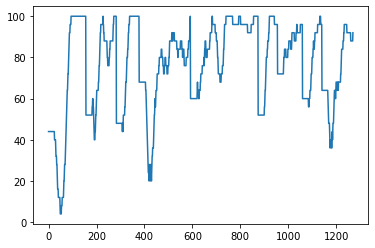

In [178]:
m_performance = np.zeros(len(outcome))
cor = 0
b=0
tot = 25
for i in range(tot):
    if outcome[i]==0:
        cor += 1

m_performance[:tot] = 100 * (cor / tot)
# for i in range(tot, len(outcome)):
i = tot
while i<len(outcome):
    if i == border[b]:
        cor = 0
        for j in range(tot):
            if outcome[i+j]==0:
                cor += 1
        m_performance[i:i+tot] = 100 * (cor / tot)
        i += tot
        b = (b+1)%len(border)
    elif outcome[i] == outcome[i-tot]:
        m_performance[i] = m_performance[i-1]
        i += 1
    elif outcome[i]==0:
        cor += 1
        m_performance[i] = 100 * (cor / tot)
        i += 1
    else:
        cor -= 1
        m_performance[i] = 100 * (cor / tot)
        i +=1

for i in range(len(m_performance)):
    if m_performance[i]<0:
        m_performance[i] = 0
plt.plot(m_performance)
learned = np.argwhere(m_performance>80).flatten()
unlearned = np.argwhere(m_performance<50).flatten()
print(learned.shape, unlearned.shape)
# print(unlearned)

In [31]:
group = unlearned

In [179]:
rule = np.zeros(np.size(X_rates,0))
for i in range(len(rule)):
    if (target[i]=='UU'):
        if (color[i] == 'r'):
            rule[i]=0
        elif(color[i] == 'g'):
            rule[i]=1
        else:
            rule[i]=2
    elif (target[i]=='UR'):
        if (color[i] == 'r'):
            rule[i]=3
        elif(color[i] == 'g'):
            rule[i]=4
        else:
            rule[i]=5
    elif (target[i]=='RR'):
        if (color[i] == 'r'):
            rule[i]=6
        elif(color[i] == 'g'):
            rule[i]=7
        else:
            rule[i]=8
    elif (target[i]=='DR'):
        if (color[i] == 'r'):
            rule[i]=9
        elif(color[i] == 'g'):
            rule[i]=10
        else:
            rule[i]=11
    elif (target[i]=='DD'):
        if (color[i] == 'r'):
            rule[i]=12
        elif(color[i] == 'g'):
            rule[i]=13
        else:
            rule[i]=14
    elif (target[i]=='DL'):
        if (color[i] == 'r'):
            rule[i]=15
        elif(color[i] == 'g'):
            rule[i]=16
        else:
            rule[i]=17
    elif (target[i]=='LL'):
        if (color[i] == 'r'):
            rule[i]=18
        elif(color[i] == 'g'):
            rule[i]=19
        else:
            rule[i]=20
    elif (target[i]=='UL'):
        if (color[i] == 'r'):
            rule[i]=21
        elif(color[i] == 'g'):
            rule[i]=22
        else:
            rule[i]=23
rule = rule.astype(int)
print(np.unique(rule, return_counts=True))
print(np.unique(rule[unlearned], return_counts=True))
print(np.unique(rule[learned], return_counts=True))

# rules = np.zeros(len(rule))
# unique = np.unique(rule)
# for i in range(len(rules)):
#     for j in range(len(unique)):
#         if rule[i] == unique[j]:
#             rules[i] = j
# rules = rules.astype(int)
# np.unique(rules, return_counts=True)
#Manual: ['UUr','UUg','UUb','URr','URg','RRg','DRr','DRg','DDr','DDg','DLr','DLb','LLr','ULb']
#['UUr','UUb','URr','URg','RRg','DRr','DRg','DDg','DLr','DLb','LLr','ULb']

(array([ 0,  1,  2,  3,  4,  7,  9, 10, 12, 13, 15, 17, 18, 23]), array([ 50,   1, 127,  63, 157, 141,  61,  50,   7, 156,  36, 162, 138,
       121], dtype=int64))
(array([ 2,  3,  4,  9, 13, 17, 23]), array([53, 10, 13,  2, 50, 29,  7], dtype=int64))
(array([ 0,  2,  3,  4,  7,  9, 10, 12, 13, 15, 17, 18, 23]), array([ 24,  59,  26,  54, 103,  31,  32,   4,  79,  20,  57,  86,  63],
      dtype=int64))


In [180]:
r1 = 3
r2 = 4
r3 = np.inf

In [181]:
cor = np.array(np.where(outcome==0)).flatten()
icor = np.array(np.where(outcome==9)).flatten()
c_l = []
ic_ul = []
for c in cor:
    if c in learned:
        c_l.append(c)
for ic in icor:
    if ic in unlearned:
        ic_ul.append(ic)
print(np.unique(rule[c_l], return_counts=True))
print(np.unique(rule[ic_ul], return_counts=True))

(array([ 0,  2,  3,  4,  7,  9, 10, 12, 13, 15, 17, 18, 23]), array([ 23,  59,  24,  49, 102,  31,  29,   4,  79,  18,  55,  79,  57],
      dtype=int64))
(array([ 2,  3,  4, 13, 17, 23]), array([45,  5, 10, 21, 13,  4], dtype=int64))


In [182]:
right_red_blue = np.array(np.where((rule==r1)|(rule==r2)|(rule==r3))).flatten()
ul_dc = []
l_dc = []
for rrb in right_red_blue:
    if rrb in unlearned:
        ul_dc.append(rrb)
    elif rrb in learned:
        l_dc.append(rrb)
print(ul_dc)
print(l_dc)

[411, 412, 414, 417, 418, 422, 427, 432, 433, 435, 436, 437, 438, 1170, 1172, 1173, 1174, 1175, 1176, 1177, 1182, 1184, 1187]
[472, 506, 507, 509, 514, 515, 516, 519, 521, 523, 525, 531, 532, 534, 535, 536, 537, 541, 545, 546, 547, 548, 549, 550, 551, 552, 556, 557, 562, 563, 582, 585, 586, 587, 589, 590, 591, 1103, 1104, 1110, 1112, 1114, 1116, 1117, 1119, 1120, 1121, 1124, 1127, 1128, 1130, 1131, 1132, 1133, 1223, 1226, 1231, 1233, 1234, 1235, 1236, 1239, 1242, 1243, 1244, 1246, 1247, 1249, 1250, 1253, 1255, 1258, 1259, 1260, 1261, 1263, 1264, 1265, 1266, 1268]


# DR on Right-Red, -Blue

### Unlearned

In [196]:
# chs = [2,5,6,10,11,17,19,21,22,23,24,28,30,31]
state_inputs = X_rates[ul_dc,50:185,:]
tsne_vals = np.zeros((state_inputs.shape[0], state_inputs.shape[1], 2))
fa = FactorAnalysis(n_components=10, random_state=0,max_iter=2000)
pca = PCA(n_components=16)
tsne = TSNE(n_components=2,perplexity=10)
for trial in range(state_inputs.shape[0]):
#     tsne_vals[trial] = fa.fit_transform(np.squeeze(state_inputs[trial]))
    tsne_vals[trial] = tsne.fit_transform(pca.fit_transform(np.squeeze(state_inputs[trial])))
# state_inputs = state_inputs[:,:,chs]
# tmp = np.reshape(state_inputs, (state_inputs.shape[0] * state_inputs.shape[1], state_inputs.shape[2]))
# fa_values = FactorAnalysis(n_components=10, random_state=0,max_iter=2000).fit_transform(tmp)
# # pca_values = PCA(n_components=10).fit_transform(tmp)
# # pca_values = TSNE(n_components=3,perplexity=10).fit_transform(fa_values)
# dr_inputs = np.reshape(fa_values, (state_inputs.shape[0], state_inputs.shape[1], fa_values.shape[1]))
print(state_inputs.shape, tsne_vals.shape)

(23, 135, 36) (23, 135, 2)


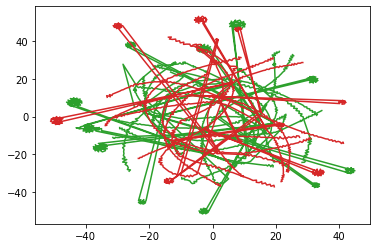

In [197]:
color_map = ['tab:blue', 'tab:red', 'tab:green']
for j in range(len(tsne_vals)):
    if color[ul_dc[j]]=='b':
        plt.plot(tsne_vals[j, :, 0], tsne_vals[j, :, 1], color_map[0])
    elif color[ul_dc[j]]=='r':
        plt.plot(tsne_vals[j, :, 0], tsne_vals[j, :, 1], color_map[1])
    else:
        plt.plot(tsne_vals[j, :, 0], tsne_vals[j, :, 1], color_map[2])

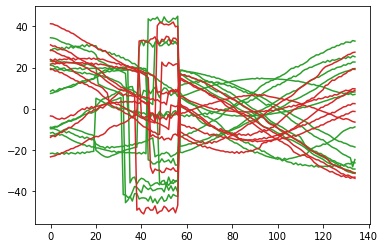

In [198]:
for j in range(len(tsne_vals)):
    if color[ul_dc[j]]=='b':
        plt.plot(tsne_vals[j, :,0], color=color_map[0])
    elif color[ul_dc[j]]=='r':
        plt.plot(tsne_vals[j, :, 0], color=color_map[1])
    else:
        plt.plot(tsne_vals[j, :, 0], color=color_map[2])

In [199]:
color[ul_dc]

array(['g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g',
       'r', 'r', 'r', 'r', 'r', 'r', 'r', 'r', 'r', 'r'], dtype=object)

In [200]:
m_b = np.mean(tsne_vals[:14], axis=0)
m_r = np.mean(tsne_vals[14:], axis=0)
v_b = np.var(tsne_vals[:14], axis=0)
v_r = np.var(tsne_vals[14:], axis=0)
t = times[50:185]
print(color[ul_r_rb[13]], color[ul_r_rb[14]], m_b.shape, v_b.shape)

b b (135, 2) (135, 2)


(-10.0, 10.0)

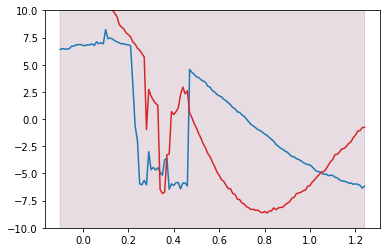

In [203]:
plt.plot(t,m_b[:,0], color='tab:blue')
plt.fill_between(t, m_b[:,0]-v_b[:,0], m_b[:,0]+v_b[:,0], alpha=0.1, color='tab:blue')
plt.plot(t,m_r[:,0], color='tab:red')
plt.fill_between(t, m_r[:,0]-v_r[:,0], m_r[:,0]+v_r[:,0], alpha=0.1, color='tab:red')
plt.ylim(-10, 10)

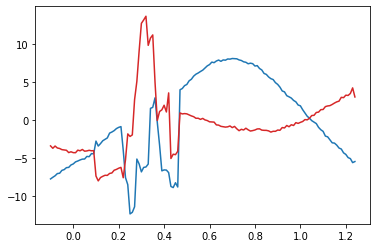

In [204]:
plt.plot(t,m_b[:,0]-m_r[:,0], color='tab:blue')
plt.plot(t,m_b[:,1]-m_r[:,1], color='tab:red')

### Learned

In [205]:
# chs = [2,5,6,10,11,17,19,21,22,23,24,28,30,31]
state_inputs = X_rates[l_dc,50:185,:]
tsne_vals = np.zeros((state_inputs.shape[0], state_inputs.shape[1], 2))
fa = FactorAnalysis(n_components=10, random_state=0,max_iter=2000)
pca = PCA(n_components=16)
tsne = TSNE(n_components=2,perplexity=10)
for trial in range(state_inputs.shape[0]):
#     tsne_vals[trial] = fa.fit_transform(np.squeeze(state_inputs[trial]))
    tsne_vals[trial] = tsne.fit_transform(pca.fit_transform(np.squeeze(state_inputs[trial])))
# state_inputs = state_inputs[:,:,chs]
# tmp = np.reshape(state_inputs, (state_inputs.shape[0] * state_inputs.shape[1], state_inputs.shape[2]))
# fa_values = FactorAnalysis(n_components=10, random_state=0,max_iter=2000).fit_transform(tmp)
# # pca_values = PCA(n_components=10).fit_transform(tmp)
# # pca_values = TSNE(n_components=3,perplexity=10).fit_transform(fa_values)
# dr_inputs = np.reshape(fa_values, (state_inputs.shape[0], state_inputs.shape[1], fa_values.shape[1]))
print(state_inputs.shape, tsne_vals.shape)

(80, 135, 36) (80, 135, 2)


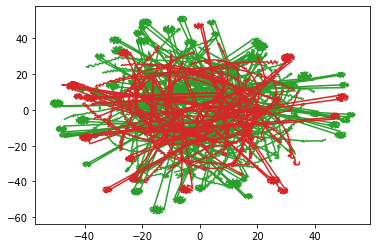

In [206]:
color_map = ['tab:blue', 'tab:red', 'tab:green']
for j in range(len(tsne_vals)):
    if color[l_dc[j]]=='b':
        plt.plot(tsne_vals[j, :, 0], tsne_vals[j, :, 1], color_map[0])
    elif color[l_dc[j]]=='r':
        plt.plot(tsne_vals[j, :, 0], tsne_vals[j, :, 1], color_map[1])
    else:
        plt.plot(tsne_vals[j, :, 0], tsne_vals[j, :, 1], color_map[2])

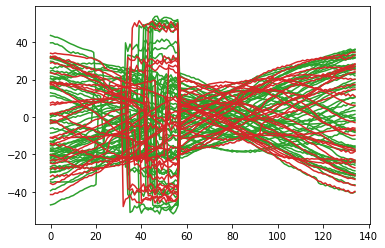

In [207]:
for j in range(len(tsne_vals)):
    if color[l_dc[j]]=='b':
        plt.plot(tsne_vals[j, :,0], color=color_map[0])
    elif color[l_dc[j]]=='r':
        plt.plot(tsne_vals[j, :, 0], color=color_map[1])
    else:
        plt.plot(tsne_vals[j, :, 0], color=color_map[2])

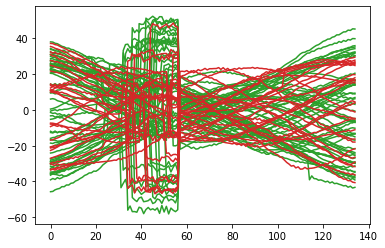

In [208]:
for j in range(len(tsne_vals)):
    if color[l_dc[j]]=='b':
        plt.plot(tsne_vals[j, :,1], color=color_map[0])
    elif color[l_dc[j]]=='r':
        plt.plot(tsne_vals[j, :, 1], color=color_map[1])
    else:
        plt.plot(tsne_vals[j, :, 1], color=color_map[2])

In [209]:
color[l_dc]

array(['g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g',
       'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g',
       'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g',
       'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g', 'g',
       'g', 'g', 'r', 'r', 'r', 'r', 'r', 'r', 'r', 'r', 'r', 'r', 'r',
       'r', 'r', 'r', 'r', 'r', 'r', 'r', 'r', 'r', 'r', 'r', 'r', 'r',
       'r', 'r'], dtype=object)

In [212]:
m_b = np.mean(tsne_vals[:55], axis=0)
m_r = np.mean(tsne_vals[55:], axis=0)
v_b = np.var(tsne_vals[:55], axis=0)
v_r = np.var(tsne_vals[55:], axis=0)
t = times[50:185]
print(color[l_r_rb[54]], color[l_r_rb[55]], m_b.shape, v_b.shape)

g b (135, 2) (135, 2)


(-10.0, 10.0)

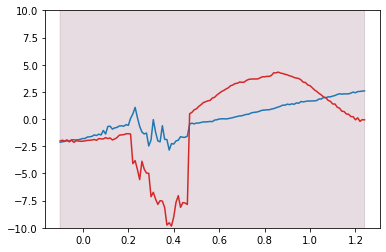

In [213]:
plt.plot(t,m_b[:,0], color='tab:blue')
plt.fill_between(t, m_b[:,0]-v_b[:,0], m_b[:,0]+v_b[:,0], alpha=0.1, color='tab:blue')
plt.plot(t,m_r[:,0], color='tab:red')
plt.fill_between(t, m_r[:,0]-v_r[:,0], m_r[:,0]+v_r[:,0], alpha=0.1, color='tab:red')
plt.ylim(-10, 10)

In [214]:
a = X_rates.reshape([-1, np.prod(X_rates.shape[1:])])
a.shape

(1270, 9864)

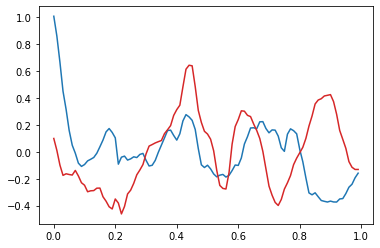

In [115]:
plt.plot(t,m_b[:,0]-m_r[:,0], color='tab:blue')
plt.plot(t,m_b[:,1]-m_r[:,1], color='tab:red')

# Dimensionality Reduction on Rates

In [27]:
# chs = [2,5,6,10,11,17,19,21,22,23,24,28,30,31]
state_inputs = np.transpose(X_rates[group], [0, 2, 1])
# state_inputs = state_inputs[:,:,chs]
tmp = np.reshape(state_inputs, (state_inputs.shape[0] * state_inputs.shape[1], state_inputs.shape[2]))
fa_values = FactorAnalysis(n_components=10, random_state=0,max_iter=2000).fit_transform(tmp)
# pca_values = PCA(n_components=10).fit_transform(tmp)
# pca_values = TSNE(n_components=3,perplexity=10).fit_transform(fa_values)
dr_inputs = np.reshape(fa_values, (state_inputs.shape[0], state_inputs.shape[1], fa_values.shape[1]))

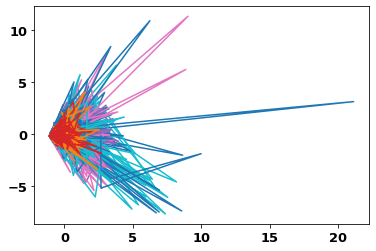

In [28]:
color_map = ['tab:blue', 'tab:red', 'tab:green', 'tab:pink','tab:cyan','tab:orange', 'tab:olive', 'tab:purple']
for j in range(len(dr_inputs)):
    plt.plot(dr_inputs[j, :, 0], dr_inputs[j, :, 1], color_map[int(Y[j])])

In [29]:
_Y = Y[group]
mean_ld = np.zeros((len(np.unique(_Y)), np.size(dr_inputs,1), np.size(dr_inputs,2)))
var_ld = np.zeros((len(np.unique(_Y)), np.size(dr_inputs,1), np.size(dr_inputs,2)))
for i in range(len(mean_ld)):
    tmp = dr_inputs[np.argwhere(_Y==i).flatten()]
    mean_ld[i] = np.mean(tmp,axis=0)
    var_ld[i] = np.var(tmp,axis=0)

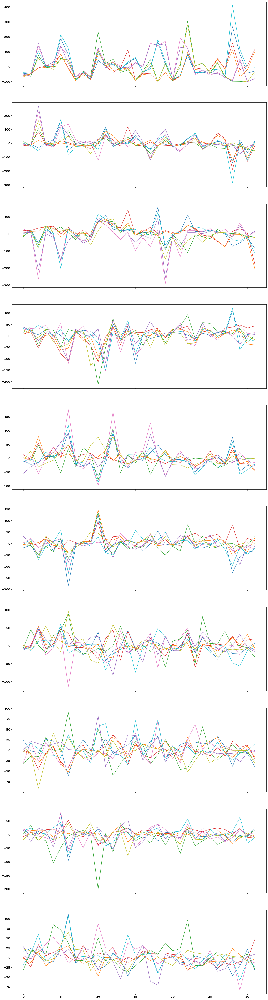

In [30]:
font = {'weight' : 'bold',
        'size'   : 13}

matplotlib.rc('font', **font)


t = list(range(np.size(mean_ld,1)))
# t = list(range(150))
fig, axs = plt.subplots(10, 1, sharex=True, figsize=(20,80))
for i in range(len(mean_ld)):
    for j in range(np.size(mean_ld,2)):
        axs[j].plot(t, 100*mean_ld[i,:,j], color=color_map[i])
#         axs[j].fill_between(t, 100*(mean_ld[i,:,j]-var_ld[i,:,j]), 100*(mean_ld[i,:,j]+var_ld[i,:,j]) ,alpha=0.1, color=color_map[i])
#         axs[j].vlines(25, -100, 300, colors='k', linestyles='solid')
#         axs[j].vlines(50, -100, 300, colors='k', linestyles='solid')
#         axs[j].vlines(150, -100, 300, colors='k', linestyles='solid')

## FA Component on Rates/Targets

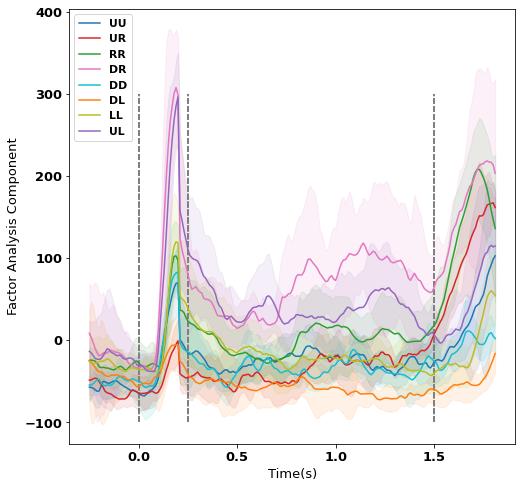

In [32]:
from matplotlib.ticker import FormatStrFormatter

font = {'weight' : 'bold',
        'size'   : 13}

matplotlib.rc('font', **font)
color_map = ['tab:blue', 'tab:red', 'tab:green', 'tab:pink','tab:cyan','tab:orange', 'tab:olive', 'tab:purple']
labels = ['UU', 'UR', 'RR', 'DR', 'DD', 'DL', 'LL', 'UL']
fig, ax = plt.subplots(figsize=(8,8))
t = list(times)
# t = list(range(150))
for i in range(np.size(mean_ld,0)):
    ax.plot(t, 100*mean_ld[i,:,1], color=color_map[i], label = labels[i])
    ax.fill_between(t, 100*(mean_ld[i,:,1]-var_ld[i,:,1]), 100*(mean_ld[i,:,1]+var_ld[i,:,1]) ,alpha=0.1, color=color_map[i])
    ax.vlines(0, -100, 300, colors='grey', linestyles='dashed')
    ax.vlines(0.25, -100, 300, colors='grey', linestyles='dashed')
    ax.vlines(1.5, -100, 300, colors='grey', linestyles='dashed')

ax.set(xlabel="Time(s)",ylabel="Factor Analysis Component")
ax.legend(loc='upper left', fontsize='small')

In [44]:
mean_ld = np.zeros((len(np.unique(rules)), np.size(dr_inputs,1), np.size(dr_inputs,2)))
var_ld = np.zeros((len(np.unique(rules)), np.size(dr_inputs,1), np.size(dr_inputs,2)))
for i in range(len(mean_ld)):
    tmp = dr_inputs[np.argwhere(rules==i).flatten()]
    mean_ld[i] = np.mean(tmp,axis=0)
    var_ld[i] = np.var(tmp,axis=0)

In [46]:
labels = ['UUr','UUb','URr','URg','RRg','DRr','DRg','DDg','DLr','DLb','LLr','ULb']
# color_map = ['tab:blue', 'tab:red', 'tab:green', 'tab:pink','tab:cyan','tab:orange', 'tab:olive', 'tab:purple', 'tab:salmon',
#             'tab:maroon', 'tab:tan', 'tab:navy', 'tab:lime', 'tab:sienna']
color_map = ['tab:blue', 'tab:red', 'tab:green', 'tab:pink','tab:cyan','tab:orange', 'tab:olive', 'tab:purple',
            'maroon', 'tan', 'navy', 'lime']

## FA Component on Rates/Rule

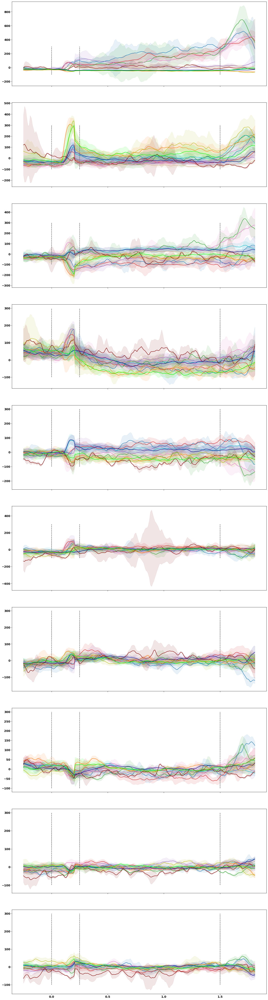

In [49]:
font = {'weight' : 'bold',
        'size'   : 13}

matplotlib.rc('font', **font)


t = list(times)
# t = list(range(150))
fig, axs = plt.subplots(10, 1, sharex=True, figsize=(20,80))
for i in range(len(mean_ld)):
    for j in range(np.size(mean_ld,2)):
        axs[j].plot(t, 100*mean_ld[i,:,j], color=color_map[i])
        axs[j].fill_between(t, 100*(mean_ld[i,:,j]-var_ld[i,:,j]), 100*(mean_ld[i,:,j]+var_ld[i,:,j]) ,alpha=0.1, color=color_map[i])
        axs[j].vlines(0, -100, 300, colors='grey', linestyles='dashed')
        axs[j].vlines(0.25, -100, 300, colors='grey', linestyles='dashed')
        axs[j].vlines(1.5, -100, 300, colors='grey', linestyles='dashed')

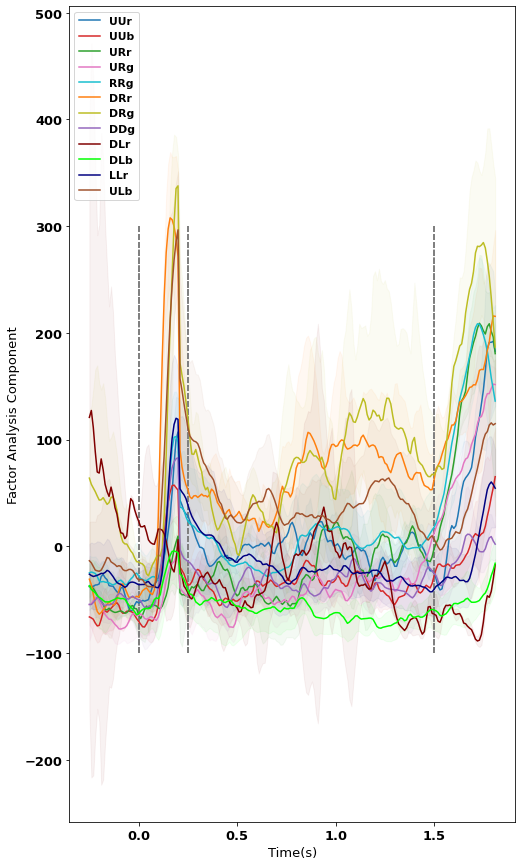

In [55]:
from matplotlib.ticker import FormatStrFormatter

font = {'weight' : 'bold',
        'size'   : 13}

matplotlib.rc('font', **font)
color_map = ['tab:blue', 'tab:red', 'tab:green', 'tab:pink','tab:cyan','tab:orange', 'tab:olive', 'tab:purple',
            'maroon', 'lime', 'navy', 'sienna']
labels = ['UUr','UUb','URr','URg','RRg','DRr','DRg','DDg','DLr','DLb','LLr','ULb']
fig, ax = plt.subplots(figsize=(8,15))
t = list(times)
# t = list(range(150))
for i in range(np.size(mean_ld,0)):
    ax.plot(t, 100*mean_ld[i,:,1], color=color_map[i], label = labels[i])
    ax.fill_between(t, 100*(mean_ld[i,:,1]-var_ld[i,:,1]), 100*(mean_ld[i,:,1]+var_ld[i,:,1]) ,alpha=0.05, color=color_map[i])
    ax.vlines(0, -100, 300, colors='grey', linestyles='dashed')
    ax.vlines(0.25, -100, 300, colors='grey', linestyles='dashed')
    ax.vlines(1.5, -100, 300, colors='grey', linestyles='dashed')

ax.set(xlabel="Time(s)",ylabel="Factor Analysis Component")
ax.legend(loc='upper left', fontsize='small')

In [116]:
X = np.transpose(X_rates, [0, 2, 1])
mean_r = np.zeros((len(np.unique(Y)), np.size(X,1), np.size(X,2)))
var_r = np.zeros((len(np.unique(Y)), np.size(X,1), np.size(X,2)))
for i in range(len(mean_ld)):
    tmp = X[np.argwhere(Y==i).flatten()]
    mean_r[i] = np.mean(tmp,axis=0)
    var_r[i] = np.var(tmp,axis=0)

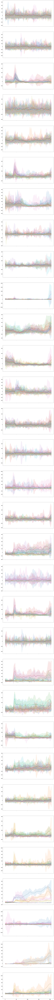

In [125]:
font = {'weight' : 'bold',
        'size'   : 13}

matplotlib.rc('font', **font)


t = list(range(np.size(mean_r,1)))
# t = list(range(150))
fig, axs = plt.subplots(np.size(mean_r,2), 1, sharex=True, figsize=(20,400))
for i in range(len(mean_r)):
    for j in range(np.size(mean_r,2)):
        axs[j].plot(t, 100*mean_r[i,:,j], color=color_map[i])
        axs[j].fill_between(t, 100*(mean_r[i,:,j]-var_r[i,:,j]), 100*(mean_r[i,:,j]+var_r[i,:,j]) ,alpha=0.1, color=color_map[i])
#         axs[j].vlines(25, -100, 300, colors='k', linestyles='solid')
#         axs[j].vlines(50, -100, 300, colors='k', linestyles='solid')
#         axs[j].vlines(150, -100, 300, colors='k', linestyles='solid')
        
    
# for i in range(len(mean_ld)):
#     axs[1].plot(t, 100*mean_ld[i,:,1], color=color_map[i])
#     axs[1].fill_between(t, 100*(mean_ld[i,:,1]-var_ld[i,:,1]), 100*(mean_ld[i,:,1]+var_ld[i,:,1]) ,alpha=0.1, color=color_map[i])
# for i in range(len(mean_ld)):
#     axs[2].plot(t, 100*mean_ld[i,:,2], color=color_map[i])
#     axs[2].fill_between(t, 100*(mean_ld[i,:,2]-var_ld[i,:,2]), 100*(mean_ld[i,:,2]+var_ld[i,:,2]) ,alpha=0.1, color=color_map[i])
# for i in range(len(mean_ld)):
#     axs[3].plot(t, 100*mean_ld[i,:,3], color=color_map[i])
#     axs[3].fill_between(t, 100*(mean_ld[i,:,3]-var_ld[i,:,3]), 100*(mean_ld[i,:,3]+var_ld[i,:,3]) ,alpha=0.1, color=color_map[i])
# for i in range(len(mean_ld)):
#     axs[4].plot(t, 100*mean_ld[i,:,4], color=color_map[i])
#     axs[4].fill_between(t, 100*(mean_ld[i,:,4]-var_ld[i,:,4]), 100*(mean_ld[i,:,4]+var_ld[i,:,4]) ,alpha=0.1, color=color_map[i])
# for i in range(len(mean_ld)):
#     axs[5].plot(t, 100*mean_ld[i,:,5], color=color_map[i])
#     axs[5].fill_between(t, 100*(mean_ld[i,:,5]-var_ld[i,:,5]), 100*(mean_ld[i,:,5]+var_ld[i,:,5]) ,alpha=0.1, color=color_map[i])
# for i in range(len(mean_ld)):
#     axs[6].plot(t, 100*mean_ld[i,:,6], color=color_map[i])
#     axs[6].fill_between(t, 100*(mean_ld[i,:,6]-var_ld[i,:,6]), 100*(mean_ld[i,:,6]+var_ld[i,:,6]) ,alpha=0.1, color=color_map[i])
# for i in range(len(mean_ld)):
#     axs[7].plot(t, 100*mean_ld[i,:,7], color=color_map[i])
#     axs[7].fill_between(t, 100*(mean_ld[i,:,7]-var_ld[i,:,7]), 100*(mean_ld[i,:,7]+var_ld[i,:,7]) ,alpha=0.1, color=color_map[i])
# for i in range(len(mean_ld)):
#     axs[8].plot(t, 100*mean_ld[i,:,8], color=color_map[i])
#     axs[8].fill_between(t, 100*(mean_ld[i,:,8]-var_ld[i,:,8]), 100*(mean_ld[i,:,8]+var_ld[i,:,8]) ,alpha=0.1, color=color_map[i])
# axs[0].fill_between(epochs, 100*(mean_shuf_acc-var_shuf_acc), 100*(mean_shuf_acc+var_shuf_acc) ,alpha=0.3)
# axs[0].set(ylabel="Accuracy(%)")
# axs[1].plot(epochs, mean_loss, label="Training")
# axs[1].fill_between(epochs, mean_loss-var_loss, mean_loss+var_loss ,alpha=0.3)
# axs[1].plot(epochs, mean_val_loss, label="Validation")
# axs[1].fill_between(epochs, mean_val_loss-var_val_loss, mean_val_loss+var_val_loss ,alpha=0.3)
# axs[1].set(xlabel="Epochs", ylabel="Loss(CCE)")
# axs[0].legend(loc='upper left', fontsize='small')
# axs[1].legend(loc='upper right', fontsize='small')

# plt.savefig("distribution.svg")


# DR on LFP

In [119]:
test_sess_ix = 1
sess_info = sess_infos[test_sess_ix]
sess_id = sess_info['exp_code']
sess_id = sess_id.replace("+", "")+"_v1"
print(f"\nImporting session {sess_id}")
X_rates, Y, ax_info = load_macaque_pfc(data_path, sess_id, x_chunk='analogsignals', **load_kwargs)
Y = np.array(Y).flatten()
Y_class = tf.keras.utils.to_categorical(Y, num_classes=8)
print(X_rates.shape, Y.shape, np.unique(Y, return_counts=True))


Importing session sra3_1_j_050_00_v1
(285, 36, 2052) (285,) (array([0, 1, 2, 3, 4, 5, 6, 7]), array([25, 20, 69, 24, 21, 37, 57, 32], dtype=int64))


In [123]:
X = np.transpose(X_rates, [0, 2, 1])
mean_a = np.zeros((len(np.unique(Y)), np.size(X,1), np.size(X,2)))
var_a = np.zeros((len(np.unique(Y)), np.size(X,1), np.size(X,2)))
for i in range(len(mean_a)):
    tmp = X[np.argwhere(Y==i).flatten()]
    mean_a[i] = np.mean(tmp,axis=0)
    var_a[i] = np.var(tmp,axis=0)

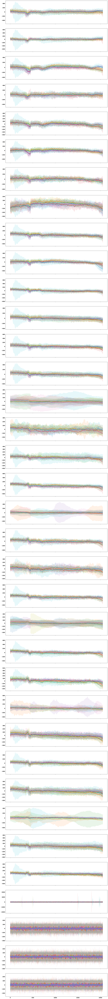

In [124]:
font = {'weight' : 'bold',
        'size'   : 13}

matplotlib.rc('font', **font)


t = list(range(np.size(mean_a,1)))
# t = list(range(150))
fig, axs = plt.subplots(np.size(mean_a,2), 1, sharex=True, figsize=(20,200))
for i in range(len(mean_a)):
    for j in range(np.size(mean_a,2)):
        axs[j].plot(t, 100*mean_a[i,:,j], color=color_map[i])
        axs[j].fill_between(t, 100*(mean_a[i,:,j]-var_a[i,:,j]), 100*(mean_a[i,:,j]+var_a[i,:,j]) ,alpha=0.1, color=color_map[i])


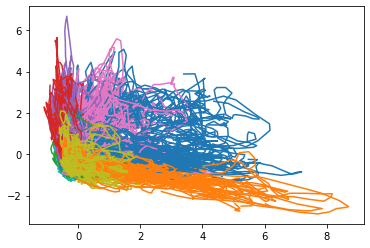

In [49]:
color_map = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:pink', 'tab:olive', 'tab:cyan', 'tab:purple']
for j in range(len(dr_inputs)):
    plt.plot(dr_inputs[j, :, 0], dr_inputs[j, :, 1], color_map[int(Y[j])])

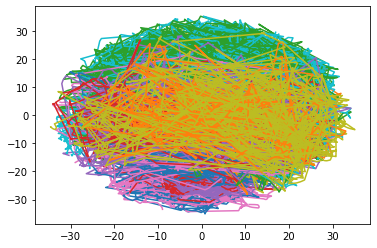

In [51]:
color_map = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:pink', 'tab:olive', 'tab:cyan', 'tab:purple']
for j in range(len(dr_inputs)):
    plt.plot(dr_inputs[j, :, 0], dr_inputs[j, :, 1], color_map[int(Y[j])])

In [12]:
from indl.model import parts
from indl.model.helper import check_inputs
from indl.regularizers import KernelLengthRegularizer

@check_inputs
def make_model(
    _input,
    num_classes,
    filt=8,
    kernLength=25,
    ds_rate=10,
    n_rnn=64,
    n_rnn2=64,
    dropoutRate=0.25,
    activation='relu',
    l1_reg=0.000, l2_reg=0.000,
    norm_rate=0.25,
    latent_dim=16,
    return_model=True
):
    
    inputs = _input
    
    input_shape = _input.shape.as_list()
    # The Conv layers are insensitive to the number of samples in the time dimension.
    # To make it possible for this trained model to be applied to segments of different
    # durations, we need to explicitly state that we don't care about the number of samples.
    # input_shape[2] = -1  # Comment out during debug
    # _y = layers.Reshape(input_shape[1:])(_input)  # Note that Reshape ignores the batch dimension.

    # RNN
    if len(input_shape) < 4:
        input_shape = input_shape + [1]
    # The Conv layers are insensitive to the number of samples in the time dimension.
    # To make it possible for this trained model to be applied to segments of different
    # durations, we need to explicitly state that we don't care about the number of samples.
    _y = tf.keras.layers.Reshape(input_shape[1:])(inputs)
    _y = tf.keras.layers.Conv2D(filt, (1, kernLength), padding='valid', data_format=None,
                                dilation_rate=(1, 1), activation=None, use_bias=True, kernel_initializer='glorot_uniform',
                                bias_initializer='zeros', kernel_regularizer=None, bias_regularizer=None,
                                activity_regularizer=None, kernel_constraint=None, bias_constraint=None)(_y)
    _y = tf.keras.layers.BatchNormalization()(_y)
    _y = tf.keras.layers.DepthwiseConv2D((_y.shape.as_list()[1], 1), padding='valid',
                                      depth_multiplier=1, data_format=None, dilation_rate=(1, 1),
                                      activation=None, use_bias=True, depthwise_initializer='glorot_uniform',
                                      bias_initializer='zeros', depthwise_regularizer=None,
                                      bias_regularizer=None, activity_regularizer=None,
                                      depthwise_constraint=None, bias_constraint=None)(_y)
    _y = tf.keras.layers.BatchNormalization()(_y)
    _y = tf.keras.layers.Activation(activation)(_y)
    _y = tf.keras.layers.AveragePooling2D(pool_size=(1, ds_rate))(_y)
    _y = tf.keras.layers.Dropout(dropoutRate)(_y)
    _y = tf.keras.layers.Reshape(_y.shape.as_list()[2:])(_y)
    _y = tf.keras.layers.LSTM(n_rnn,
                              kernel_regularizer=tf.keras.regularizers.l2(l2_reg),
                              recurrent_regularizer=tf.keras.regularizers.l2(l2_reg),
                              return_sequences=n_rnn2 > 0,
                              stateful=False,
                              name='rnn1')(_y)
    _y = tf.keras.layers.Activation(activation)(_y)
    _y = tf.keras.layers.BatchNormalization()(_y)
    _y = tf.keras.layers.Dropout(dropoutRate)(_y)
    
    
    if n_rnn2 > 0:
        
        _y = tf.keras.layers.LSTM(n_rnn2,
                              kernel_regularizer=tf.keras.regularizers.l2(l2_reg),
                              recurrent_regularizer=tf.keras.regularizers.l2(l2_reg),
                              return_sequences=False,
                              stateful=False,
                              name='rnn2')(_y)
        _y = tf.keras.layers.Activation(activation)(_y)
        _y = tf.keras.layers.BatchNormalization()(_y)
        _y = tf.keras.layers.Dropout(dropoutRate)(_y)
    
    # Dense
    _y = parts.Bottleneck(_y, latent_dim=latent_dim, activation=activation)
    
    # Classify
    outputs = parts.Classify(_y, n_classes=num_classes, norm_rate=norm_rate)
    

    if return_model is False:
        return outputs
    else:
        return tf.keras.models.Model(inputs=inputs, outputs=outputs)


def get_hists_acc(sess_id, rules, verbose=1):
    print(f"Processing session {sess_id}...")
    X_rates, Y_class, ax_info = load_macaque_pfc(data_path, sess_id, x_chunk='spikerates', **load_kwargs)
    
    splitter = StratifiedKFold(n_splits=N_SPLITS, shuffle=True, random_state=0)
    split_ix = 0
    histories = []
    per_fold_eval = []
    per_fold_true = []

    for trn, vld in splitter.split(X_rates, rules):
        print(f"\tSplit {split_ix + 1} of {N_SPLITS}")
        _y = tf.keras.utils.to_categorical(rules, num_classes=len(np.unique(rules)))
        
        ds_train = tf.data.Dataset.from_tensor_slices((X_rates[trn], _y[trn]))
        ds_valid = tf.data.Dataset.from_tensor_slices((X_rates[vld], _y[vld]))

        # cast data types to GPU-friendly types.
        ds_train = ds_train.map(lambda x, y: (tf.cast(x, tf.float32), tf.cast(y, tf.uint8)))
        ds_valid = ds_valid.map(lambda x, y: (tf.cast(x, tf.float32), tf.cast(y, tf.uint8)))

        # TODO: augmentations (random slicing?)

        ds_train = ds_train.shuffle(len(trn) + 1)
        ds_train = ds_train.batch(BATCH_SIZE, drop_remainder=True)
        ds_valid = ds_valid.batch(BATCH_SIZE, drop_remainder=False)

        tf.keras.backend.clear_session()
        
        randseed = 12345
        random.seed(randseed)
        np.random.seed(randseed)
        tf.random.set_seed(randseed)
        
        model = make_model(
            ds_train.element_spec[0],
            _y.shape[-1],
            **model_kwargs
        )
        optim = tf.keras.optimizers.Nadam(learning_rate=0.001)
        loss_obj = tf.keras.losses.CategoricalCrossentropy(label_smoothing=LABEL_SMOOTHING)
        model.compile(optimizer=optim, loss=loss_obj, metrics=['accuracy'])
        
        best_model_path = f'r2c_lstm_{sess_id}old_split{split_ix}.h5'
        callbacks = [
            tf.keras.callbacks.ModelCheckpoint(
                filepath=best_model_path,
                # Path where to save the model
                # The two parameters below mean that we will overwrite
                # the current checkpoint if and only if
                # the `val_loss` score has improved.
                save_best_only=True,
                monitor='val_accuracy',
                verbose=verbose)
        ]

        hist = model.fit(x=ds_train, epochs=EPOCHS,
                         verbose=verbose,
                         validation_data=ds_valid,
                         callbacks=callbacks)
        # tf.keras.models.save_model(model, 'model.h5')
        histories.append(hist.history)
        
        model = tf.keras.models.load_model(best_model_path)
        per_fold_eval.append(model(X_rates[vld]).numpy())
        per_fold_true.append(Y_class[vld])
        
        split_ix += 1
        
    # Combine histories into one dictionary.
    history = {}
    for h in histories:
        for k,v in h.items():
            if k not in history:
                history[k] = v
            else:
                history[k].append(np.nan)
                history[k].extend(v)
                
    pred_y = np.concatenate([np.argmax(_, axis=1) for _ in per_fold_eval])
    true_y = np.concatenate(per_fold_true).flatten()
    accuracy = 100 * np.sum(pred_y == true_y) / len(pred_y)
    print(f"Session {sess_id} overall accuracy: {accuracy}%")
    
    return history, accuracy

Processing session sra3_1_j_050_00_v1+...
	Split 1 of 10
Epoch 1/150

Epoch 00001: val_accuracy improved from -inf to 0.20690, saving model to r2c_lstm_sra3_1_j_050_00_v1+old_split0.h5
16/16 - 1s - loss: 2.5936 - accuracy: 0.1250 - val_loss: 2.5523 - val_accuracy: 0.2069
Epoch 2/150

Epoch 00002: val_accuracy did not improve from 0.20690
16/16 - 0s - loss: 2.4188 - accuracy: 0.2070 - val_loss: 2.5327 - val_accuracy: 0.2069
Epoch 3/150

Epoch 00003: val_accuracy did not improve from 0.20690
16/16 - 0s - loss: 2.2553 - accuracy: 0.3359 - val_loss: 2.5027 - val_accuracy: 0.2069
Epoch 4/150

Epoch 00004: val_accuracy improved from 0.20690 to 0.27586, saving model to r2c_lstm_sra3_1_j_050_00_v1+old_split0.h5
16/16 - 0s - loss: 2.1245 - accuracy: 0.3867 - val_loss: 2.4547 - val_accuracy: 0.2759
Epoch 5/150

Epoch 00005: val_accuracy improved from 0.27586 to 0.31034, saving model to r2c_lstm_sra3_1_j_050_00_v1+old_split0.h5
16/16 - 0s - loss: 2.0108 - accuracy: 0.4609 - val_loss: 2.3912 - val

Epoch 50/150

Epoch 00050: val_accuracy did not improve from 0.72414
16/16 - 0s - loss: 1.3974 - accuracy: 0.7656 - val_loss: 1.5855 - val_accuracy: 0.7241
Epoch 51/150

Epoch 00051: val_accuracy did not improve from 0.72414
16/16 - 0s - loss: 1.3845 - accuracy: 0.7578 - val_loss: 1.5395 - val_accuracy: 0.7241
Epoch 52/150

Epoch 00052: val_accuracy did not improve from 0.72414
16/16 - 0s - loss: 1.4104 - accuracy: 0.7734 - val_loss: 1.5165 - val_accuracy: 0.7241
Epoch 53/150

Epoch 00053: val_accuracy did not improve from 0.72414
16/16 - 0s - loss: 1.4565 - accuracy: 0.7227 - val_loss: 1.5614 - val_accuracy: 0.7241
Epoch 54/150

Epoch 00054: val_accuracy did not improve from 0.72414
16/16 - 0s - loss: 1.4095 - accuracy: 0.7344 - val_loss: 1.5346 - val_accuracy: 0.7241
Epoch 55/150

Epoch 00055: val_accuracy improved from 0.72414 to 0.75862, saving model to r2c_lstm_sra3_1_j_050_00_v1+old_split0.h5
16/16 - 0s - loss: 1.3615 - accuracy: 0.8125 - val_loss: 1.5043 - val_accuracy: 0.7586
E

Epoch 102/150

Epoch 00102: val_accuracy did not improve from 0.79310
16/16 - 0s - loss: 1.2951 - accuracy: 0.8594 - val_loss: 1.5497 - val_accuracy: 0.7586
Epoch 103/150

Epoch 00103: val_accuracy did not improve from 0.79310
16/16 - 0s - loss: 1.3235 - accuracy: 0.8359 - val_loss: 1.5598 - val_accuracy: 0.7241
Epoch 104/150

Epoch 00104: val_accuracy did not improve from 0.79310
16/16 - 0s - loss: 1.3920 - accuracy: 0.8008 - val_loss: 1.5462 - val_accuracy: 0.7586
Epoch 105/150

Epoch 00105: val_accuracy did not improve from 0.79310
16/16 - 0s - loss: 1.2656 - accuracy: 0.8594 - val_loss: 1.5986 - val_accuracy: 0.7586
Epoch 106/150

Epoch 00106: val_accuracy did not improve from 0.79310
16/16 - 0s - loss: 1.3454 - accuracy: 0.8125 - val_loss: 1.5485 - val_accuracy: 0.7241
Epoch 107/150

Epoch 00107: val_accuracy did not improve from 0.79310
16/16 - 0s - loss: 1.3240 - accuracy: 0.8516 - val_loss: 1.5667 - val_accuracy: 0.7586
Epoch 108/150

Epoch 00108: val_accuracy did not improve f

Epoch 4/150

Epoch 00004: val_accuracy did not improve from 0.24138
16/16 - 0s - loss: 2.1354 - accuracy: 0.3828 - val_loss: 2.4433 - val_accuracy: 0.2414
Epoch 5/150

Epoch 00005: val_accuracy improved from 0.24138 to 0.27586, saving model to r2c_lstm_sra3_1_j_050_00_v1+old_split1.h5
16/16 - 0s - loss: 2.0155 - accuracy: 0.4453 - val_loss: 2.3881 - val_accuracy: 0.2759
Epoch 6/150

Epoch 00006: val_accuracy improved from 0.27586 to 0.41379, saving model to r2c_lstm_sra3_1_j_050_00_v1+old_split1.h5
16/16 - 0s - loss: 1.9443 - accuracy: 0.4336 - val_loss: 2.3408 - val_accuracy: 0.4138
Epoch 7/150

Epoch 00007: val_accuracy improved from 0.41379 to 0.44828, saving model to r2c_lstm_sra3_1_j_050_00_v1+old_split1.h5
16/16 - 0s - loss: 1.8819 - accuracy: 0.5078 - val_loss: 2.2791 - val_accuracy: 0.4483
Epoch 8/150

Epoch 00008: val_accuracy did not improve from 0.44828
16/16 - 0s - loss: 1.8430 - accuracy: 0.5039 - val_loss: 2.2239 - val_accuracy: 0.4483
Epoch 9/150

Epoch 00009: val_accura

Epoch 53/150

Epoch 00053: val_accuracy did not improve from 0.79310
16/16 - 0s - loss: 1.4226 - accuracy: 0.7266 - val_loss: 1.3543 - val_accuracy: 0.7586
Epoch 54/150

Epoch 00054: val_accuracy did not improve from 0.79310
16/16 - 0s - loss: 1.4484 - accuracy: 0.7344 - val_loss: 1.3770 - val_accuracy: 0.7586
Epoch 55/150

Epoch 00055: val_accuracy did not improve from 0.79310
16/16 - 0s - loss: 1.4091 - accuracy: 0.7734 - val_loss: 1.3828 - val_accuracy: 0.7586
Epoch 56/150

Epoch 00056: val_accuracy did not improve from 0.79310
16/16 - 0s - loss: 1.4303 - accuracy: 0.7383 - val_loss: 1.4231 - val_accuracy: 0.7586
Epoch 57/150

Epoch 00057: val_accuracy did not improve from 0.79310
16/16 - 0s - loss: 1.3864 - accuracy: 0.7852 - val_loss: 1.4181 - val_accuracy: 0.7931
Epoch 58/150

Epoch 00058: val_accuracy did not improve from 0.79310
16/16 - 0s - loss: 1.3885 - accuracy: 0.7695 - val_loss: 1.3925 - val_accuracy: 0.7931
Epoch 59/150

Epoch 00059: val_accuracy did not improve from 0.7

Epoch 106/150

Epoch 00106: val_accuracy did not improve from 0.79310
16/16 - 0s - loss: 1.3099 - accuracy: 0.8164 - val_loss: 1.3946 - val_accuracy: 0.7931
Epoch 107/150

Epoch 00107: val_accuracy did not improve from 0.79310
16/16 - 0s - loss: 1.3595 - accuracy: 0.7930 - val_loss: 1.4011 - val_accuracy: 0.7586
Epoch 108/150

Epoch 00108: val_accuracy did not improve from 0.79310
16/16 - 0s - loss: 1.3377 - accuracy: 0.8281 - val_loss: 1.4278 - val_accuracy: 0.7586
Epoch 109/150

Epoch 00109: val_accuracy did not improve from 0.79310
16/16 - 0s - loss: 1.3002 - accuracy: 0.8320 - val_loss: 1.4541 - val_accuracy: 0.7241
Epoch 110/150

Epoch 00110: val_accuracy did not improve from 0.79310
16/16 - 0s - loss: 1.3126 - accuracy: 0.8320 - val_loss: 1.4940 - val_accuracy: 0.7241
Epoch 111/150

Epoch 00111: val_accuracy did not improve from 0.79310
16/16 - 0s - loss: 1.3277 - accuracy: 0.8008 - val_loss: 1.5278 - val_accuracy: 0.7241
Epoch 112/150

Epoch 00112: val_accuracy did not improve f

Epoch 7/150

Epoch 00007: val_accuracy did not improve from 0.37931
16/16 - 0s - loss: 1.8880 - accuracy: 0.5234 - val_loss: 2.2606 - val_accuracy: 0.3448
Epoch 8/150

Epoch 00008: val_accuracy improved from 0.37931 to 0.48276, saving model to r2c_lstm_sra3_1_j_050_00_v1+old_split2.h5
16/16 - 0s - loss: 1.8578 - accuracy: 0.4961 - val_loss: 2.2027 - val_accuracy: 0.4828
Epoch 9/150

Epoch 00009: val_accuracy did not improve from 0.48276
16/16 - 0s - loss: 1.8121 - accuracy: 0.5234 - val_loss: 2.1488 - val_accuracy: 0.4483
Epoch 10/150

Epoch 00010: val_accuracy improved from 0.48276 to 0.58621, saving model to r2c_lstm_sra3_1_j_050_00_v1+old_split2.h5
16/16 - 0s - loss: 1.8310 - accuracy: 0.4648 - val_loss: 2.0910 - val_accuracy: 0.5862
Epoch 11/150

Epoch 00011: val_accuracy did not improve from 0.58621
16/16 - 0s - loss: 1.7529 - accuracy: 0.5703 - val_loss: 2.0371 - val_accuracy: 0.5172
Epoch 12/150

Epoch 00012: val_accuracy did not improve from 0.58621
16/16 - 0s - loss: 1.7236 - 

Epoch 57/150

Epoch 00057: val_accuracy did not improve from 0.82759
16/16 - 0s - loss: 1.3949 - accuracy: 0.7695 - val_loss: 1.3433 - val_accuracy: 0.7241
Epoch 58/150

Epoch 00058: val_accuracy did not improve from 0.82759
16/16 - 0s - loss: 1.3886 - accuracy: 0.7969 - val_loss: 1.3565 - val_accuracy: 0.7586
Epoch 59/150

Epoch 00059: val_accuracy did not improve from 0.82759
16/16 - 0s - loss: 1.4428 - accuracy: 0.7539 - val_loss: 1.3736 - val_accuracy: 0.6897
Epoch 60/150

Epoch 00060: val_accuracy did not improve from 0.82759
16/16 - 0s - loss: 1.4266 - accuracy: 0.7383 - val_loss: 1.4179 - val_accuracy: 0.6897
Epoch 61/150

Epoch 00061: val_accuracy did not improve from 0.82759
16/16 - 0s - loss: 1.3999 - accuracy: 0.7852 - val_loss: 1.3186 - val_accuracy: 0.8276
Epoch 62/150

Epoch 00062: val_accuracy did not improve from 0.82759
16/16 - 0s - loss: 1.4027 - accuracy: 0.7812 - val_loss: 1.3412 - val_accuracy: 0.7931
Epoch 63/150

Epoch 00063: val_accuracy did not improve from 0.8

Epoch 109/150

Epoch 00109: val_accuracy did not improve from 0.89655
16/16 - 0s - loss: 1.2652 - accuracy: 0.8789 - val_loss: 1.2706 - val_accuracy: 0.8621
Epoch 110/150

Epoch 00110: val_accuracy did not improve from 0.89655
16/16 - 0s - loss: 1.3028 - accuracy: 0.8477 - val_loss: 1.3250 - val_accuracy: 0.7931
Epoch 111/150

Epoch 00111: val_accuracy did not improve from 0.89655
16/16 - 0s - loss: 1.2917 - accuracy: 0.8438 - val_loss: 1.2817 - val_accuracy: 0.7586
Epoch 112/150

Epoch 00112: val_accuracy did not improve from 0.89655
16/16 - 0s - loss: 1.3084 - accuracy: 0.8359 - val_loss: 1.3209 - val_accuracy: 0.7241
Epoch 113/150

Epoch 00113: val_accuracy did not improve from 0.89655
16/16 - 0s - loss: 1.3204 - accuracy: 0.8398 - val_loss: 1.3155 - val_accuracy: 0.7241
Epoch 114/150

Epoch 00114: val_accuracy did not improve from 0.89655
16/16 - 0s - loss: 1.2866 - accuracy: 0.8633 - val_loss: 1.3472 - val_accuracy: 0.7241
Epoch 115/150

Epoch 00115: val_accuracy did not improve f

Epoch 10/150

Epoch 00010: val_accuracy improved from 0.41379 to 0.44828, saving model to r2c_lstm_sra3_1_j_050_00_v1+old_split3.h5
16/16 - 0s - loss: 1.7650 - accuracy: 0.5508 - val_loss: 2.0569 - val_accuracy: 0.4483
Epoch 11/150

Epoch 00011: val_accuracy did not improve from 0.44828
16/16 - 0s - loss: 1.7636 - accuracy: 0.5781 - val_loss: 2.0238 - val_accuracy: 0.4138
Epoch 12/150

Epoch 00012: val_accuracy did not improve from 0.44828
16/16 - 0s - loss: 1.6993 - accuracy: 0.5820 - val_loss: 1.9773 - val_accuracy: 0.4483
Epoch 13/150

Epoch 00013: val_accuracy improved from 0.44828 to 0.58621, saving model to r2c_lstm_sra3_1_j_050_00_v1+old_split3.h5
16/16 - 0s - loss: 1.6545 - accuracy: 0.6172 - val_loss: 1.9305 - val_accuracy: 0.5862
Epoch 14/150

Epoch 00014: val_accuracy did not improve from 0.58621
16/16 - 0s - loss: 1.6575 - accuracy: 0.5898 - val_loss: 1.8829 - val_accuracy: 0.5517
Epoch 15/150

Epoch 00015: val_accuracy did not improve from 0.58621
16/16 - 0s - loss: 1.6902

Epoch 61/150

Epoch 00061: val_accuracy did not improve from 0.75862
16/16 - 0s - loss: 1.3881 - accuracy: 0.7930 - val_loss: 1.5151 - val_accuracy: 0.6552
Epoch 62/150

Epoch 00062: val_accuracy did not improve from 0.75862
16/16 - 0s - loss: 1.3893 - accuracy: 0.8047 - val_loss: 1.5232 - val_accuracy: 0.6552
Epoch 63/150

Epoch 00063: val_accuracy did not improve from 0.75862
16/16 - 0s - loss: 1.3369 - accuracy: 0.8125 - val_loss: 1.4981 - val_accuracy: 0.6552
Epoch 64/150

Epoch 00064: val_accuracy did not improve from 0.75862
16/16 - 0s - loss: 1.3177 - accuracy: 0.8359 - val_loss: 1.5196 - val_accuracy: 0.7241
Epoch 65/150

Epoch 00065: val_accuracy did not improve from 0.75862
16/16 - 0s - loss: 1.3776 - accuracy: 0.7969 - val_loss: 1.4691 - val_accuracy: 0.6897
Epoch 66/150

Epoch 00066: val_accuracy did not improve from 0.75862
16/16 - 0s - loss: 1.4188 - accuracy: 0.8008 - val_loss: 1.4864 - val_accuracy: 0.7241
Epoch 67/150

Epoch 00067: val_accuracy did not improve from 0.7

Epoch 114/150

Epoch 00114: val_accuracy did not improve from 0.75862
16/16 - 0s - loss: 1.3393 - accuracy: 0.8281 - val_loss: 1.6143 - val_accuracy: 0.6897
Epoch 115/150

Epoch 00115: val_accuracy did not improve from 0.75862
16/16 - 0s - loss: 1.2914 - accuracy: 0.8438 - val_loss: 1.5576 - val_accuracy: 0.6207
Epoch 116/150

Epoch 00116: val_accuracy did not improve from 0.75862
16/16 - 0s - loss: 1.2979 - accuracy: 0.8359 - val_loss: 1.5304 - val_accuracy: 0.7241
Epoch 117/150

Epoch 00117: val_accuracy did not improve from 0.75862
16/16 - 0s - loss: 1.3220 - accuracy: 0.8398 - val_loss: 1.5523 - val_accuracy: 0.7241
Epoch 118/150

Epoch 00118: val_accuracy did not improve from 0.75862
16/16 - 0s - loss: 1.3012 - accuracy: 0.8359 - val_loss: 1.5770 - val_accuracy: 0.6897
Epoch 119/150

Epoch 00119: val_accuracy did not improve from 0.75862
16/16 - 0s - loss: 1.2481 - accuracy: 0.8828 - val_loss: 1.5915 - val_accuracy: 0.6897
Epoch 120/150

Epoch 00120: val_accuracy did not improve f

Epoch 14/150

Epoch 00014: val_accuracy improved from 0.55172 to 0.58621, saving model to r2c_lstm_sra3_1_j_050_00_v1+old_split4.h5
16/16 - 0s - loss: 1.6531 - accuracy: 0.5664 - val_loss: 1.8452 - val_accuracy: 0.5862
Epoch 15/150

Epoch 00015: val_accuracy did not improve from 0.58621
16/16 - 0s - loss: 1.6977 - accuracy: 0.5820 - val_loss: 1.8221 - val_accuracy: 0.5517
Epoch 16/150

Epoch 00016: val_accuracy did not improve from 0.58621
16/16 - 0s - loss: 1.6555 - accuracy: 0.5898 - val_loss: 1.7330 - val_accuracy: 0.5862
Epoch 17/150

Epoch 00017: val_accuracy did not improve from 0.58621
16/16 - 0s - loss: 1.6668 - accuracy: 0.6016 - val_loss: 1.7618 - val_accuracy: 0.5517
Epoch 18/150

Epoch 00018: val_accuracy did not improve from 0.58621
16/16 - 0s - loss: 1.6017 - accuracy: 0.6094 - val_loss: 1.6858 - val_accuracy: 0.5172
Epoch 19/150

Epoch 00019: val_accuracy did not improve from 0.58621
16/16 - 0s - loss: 1.6106 - accuracy: 0.6484 - val_loss: 1.6530 - val_accuracy: 0.5862
E

Epoch 66/150

Epoch 00066: val_accuracy did not improve from 0.65517
16/16 - 0s - loss: 1.3537 - accuracy: 0.8320 - val_loss: 1.6289 - val_accuracy: 0.5172
Epoch 67/150

Epoch 00067: val_accuracy did not improve from 0.65517
16/16 - 0s - loss: 1.3906 - accuracy: 0.7812 - val_loss: 1.5659 - val_accuracy: 0.5862
Epoch 68/150

Epoch 00068: val_accuracy did not improve from 0.65517
16/16 - 0s - loss: 1.4016 - accuracy: 0.7891 - val_loss: 1.5817 - val_accuracy: 0.6207
Epoch 69/150

Epoch 00069: val_accuracy did not improve from 0.65517
16/16 - 0s - loss: 1.3521 - accuracy: 0.8203 - val_loss: 1.6043 - val_accuracy: 0.6207
Epoch 70/150

Epoch 00070: val_accuracy did not improve from 0.65517
16/16 - 0s - loss: 1.3460 - accuracy: 0.8320 - val_loss: 1.5966 - val_accuracy: 0.5517
Epoch 71/150

Epoch 00071: val_accuracy did not improve from 0.65517
16/16 - 0s - loss: 1.3605 - accuracy: 0.8125 - val_loss: 1.5697 - val_accuracy: 0.6552
Epoch 72/150

Epoch 00072: val_accuracy did not improve from 0.6

Epoch 118/150

Epoch 00118: val_accuracy did not improve from 0.68966
16/16 - 0s - loss: 1.2525 - accuracy: 0.8750 - val_loss: 1.7090 - val_accuracy: 0.6207
Epoch 119/150

Epoch 00119: val_accuracy did not improve from 0.68966
16/16 - 0s - loss: 1.2722 - accuracy: 0.8438 - val_loss: 1.7740 - val_accuracy: 0.5862
Epoch 120/150

Epoch 00120: val_accuracy did not improve from 0.68966
16/16 - 0s - loss: 1.2908 - accuracy: 0.8398 - val_loss: 1.7238 - val_accuracy: 0.6552
Epoch 121/150

Epoch 00121: val_accuracy did not improve from 0.68966
16/16 - 0s - loss: 1.2846 - accuracy: 0.8359 - val_loss: 1.7431 - val_accuracy: 0.6207
Epoch 122/150

Epoch 00122: val_accuracy did not improve from 0.68966
16/16 - 0s - loss: 1.2442 - accuracy: 0.8828 - val_loss: 1.7239 - val_accuracy: 0.6207
Epoch 123/150

Epoch 00123: val_accuracy did not improve from 0.68966
16/16 - 0s - loss: 1.3283 - accuracy: 0.8125 - val_loss: 1.7961 - val_accuracy: 0.5862
Epoch 124/150

Epoch 00124: val_accuracy did not improve f

Epoch 17/150

Epoch 00017: val_accuracy did not improve from 0.64286
16/16 - 0s - loss: 1.6377 - accuracy: 0.6367 - val_loss: 1.7252 - val_accuracy: 0.5714
Epoch 18/150

Epoch 00018: val_accuracy did not improve from 0.64286
16/16 - 0s - loss: 1.6867 - accuracy: 0.6133 - val_loss: 1.6819 - val_accuracy: 0.6071
Epoch 19/150

Epoch 00019: val_accuracy improved from 0.64286 to 0.71429, saving model to r2c_lstm_sra3_1_j_050_00_v1+old_split5.h5
16/16 - 0s - loss: 1.6125 - accuracy: 0.6055 - val_loss: 1.6040 - val_accuracy: 0.7143
Epoch 20/150

Epoch 00020: val_accuracy did not improve from 0.71429
16/16 - 0s - loss: 1.6263 - accuracy: 0.6250 - val_loss: 1.5974 - val_accuracy: 0.6786
Epoch 21/150

Epoch 00021: val_accuracy did not improve from 0.71429
16/16 - 0s - loss: 1.5951 - accuracy: 0.6133 - val_loss: 1.5463 - val_accuracy: 0.7143
Epoch 22/150

Epoch 00022: val_accuracy did not improve from 0.71429
16/16 - 0s - loss: 1.5544 - accuracy: 0.6484 - val_loss: 1.5488 - val_accuracy: 0.6429
E

Epoch 69/150

Epoch 00069: val_accuracy did not improve from 0.82143
16/16 - 0s - loss: 1.3981 - accuracy: 0.7695 - val_loss: 1.3742 - val_accuracy: 0.7500
Epoch 70/150

Epoch 00070: val_accuracy did not improve from 0.82143
16/16 - 0s - loss: 1.4211 - accuracy: 0.7461 - val_loss: 1.3952 - val_accuracy: 0.7500
Epoch 71/150

Epoch 00071: val_accuracy did not improve from 0.82143
16/16 - 0s - loss: 1.3758 - accuracy: 0.7930 - val_loss: 1.3782 - val_accuracy: 0.7500
Epoch 72/150

Epoch 00072: val_accuracy did not improve from 0.82143
16/16 - 0s - loss: 1.3742 - accuracy: 0.7617 - val_loss: 1.3840 - val_accuracy: 0.7143
Epoch 73/150

Epoch 00073: val_accuracy did not improve from 0.82143
16/16 - 0s - loss: 1.3790 - accuracy: 0.8008 - val_loss: 1.3706 - val_accuracy: 0.7143
Epoch 74/150

Epoch 00074: val_accuracy did not improve from 0.82143
16/16 - 0s - loss: 1.3924 - accuracy: 0.7891 - val_loss: 1.3591 - val_accuracy: 0.7500
Epoch 75/150

Epoch 00075: val_accuracy did not improve from 0.8

Epoch 122/150

Epoch 00122: val_accuracy did not improve from 0.82143
16/16 - 0s - loss: 1.2944 - accuracy: 0.8516 - val_loss: 1.4072 - val_accuracy: 0.7500
Epoch 123/150

Epoch 00123: val_accuracy did not improve from 0.82143
16/16 - 0s - loss: 1.3060 - accuracy: 0.8242 - val_loss: 1.4788 - val_accuracy: 0.7143
Epoch 124/150

Epoch 00124: val_accuracy did not improve from 0.82143
16/16 - 0s - loss: 1.3591 - accuracy: 0.8242 - val_loss: 1.3993 - val_accuracy: 0.7857
Epoch 125/150

Epoch 00125: val_accuracy did not improve from 0.82143
16/16 - 0s - loss: 1.2953 - accuracy: 0.8516 - val_loss: 1.4332 - val_accuracy: 0.7143
Epoch 126/150

Epoch 00126: val_accuracy did not improve from 0.82143
16/16 - 0s - loss: 1.2817 - accuracy: 0.8672 - val_loss: 1.3969 - val_accuracy: 0.7143
Epoch 127/150

Epoch 00127: val_accuracy did not improve from 0.82143
16/16 - 0s - loss: 1.2383 - accuracy: 0.9062 - val_loss: 1.4575 - val_accuracy: 0.7143
Epoch 128/150

Epoch 00128: val_accuracy did not improve f


Epoch 00021: val_accuracy improved from 0.75000 to 0.78571, saving model to r2c_lstm_sra3_1_j_050_00_v1+old_split6.h5
16/16 - 0s - loss: 1.5980 - accuracy: 0.6367 - val_loss: 1.6078 - val_accuracy: 0.7857
Epoch 22/150

Epoch 00022: val_accuracy did not improve from 0.78571
16/16 - 0s - loss: 1.5763 - accuracy: 0.6250 - val_loss: 1.5758 - val_accuracy: 0.7500
Epoch 23/150

Epoch 00023: val_accuracy did not improve from 0.78571
16/16 - 0s - loss: 1.5858 - accuracy: 0.6562 - val_loss: 1.5778 - val_accuracy: 0.6786
Epoch 24/150

Epoch 00024: val_accuracy did not improve from 0.78571
16/16 - 0s - loss: 1.6059 - accuracy: 0.6562 - val_loss: 1.5356 - val_accuracy: 0.7500
Epoch 25/150

Epoch 00025: val_accuracy did not improve from 0.78571
16/16 - 0s - loss: 1.5853 - accuracy: 0.6328 - val_loss: 1.5136 - val_accuracy: 0.7143
Epoch 26/150

Epoch 00026: val_accuracy did not improve from 0.78571
16/16 - 0s - loss: 1.5879 - accuracy: 0.6094 - val_loss: 1.4885 - val_accuracy: 0.7500
Epoch 27/150



Epoch 73/150

Epoch 00073: val_accuracy did not improve from 0.89286
16/16 - 0s - loss: 1.3749 - accuracy: 0.7891 - val_loss: 1.3288 - val_accuracy: 0.7500
Epoch 74/150

Epoch 00074: val_accuracy did not improve from 0.89286
16/16 - 0s - loss: 1.4171 - accuracy: 0.7656 - val_loss: 1.3765 - val_accuracy: 0.7143
Epoch 75/150

Epoch 00075: val_accuracy did not improve from 0.89286
16/16 - 0s - loss: 1.3613 - accuracy: 0.7891 - val_loss: 1.3382 - val_accuracy: 0.8214
Epoch 76/150

Epoch 00076: val_accuracy did not improve from 0.89286
16/16 - 0s - loss: 1.3595 - accuracy: 0.7930 - val_loss: 1.3195 - val_accuracy: 0.8214
Epoch 77/150

Epoch 00077: val_accuracy did not improve from 0.89286
16/16 - 0s - loss: 1.3370 - accuracy: 0.8164 - val_loss: 1.3562 - val_accuracy: 0.8214
Epoch 78/150

Epoch 00078: val_accuracy did not improve from 0.89286
16/16 - 0s - loss: 1.3980 - accuracy: 0.7500 - val_loss: 1.3195 - val_accuracy: 0.8214
Epoch 79/150

Epoch 00079: val_accuracy did not improve from 0.8

Epoch 126/150

Epoch 00126: val_accuracy did not improve from 0.89286
16/16 - 0s - loss: 1.2705 - accuracy: 0.8594 - val_loss: 1.4619 - val_accuracy: 0.7500
Epoch 127/150

Epoch 00127: val_accuracy did not improve from 0.89286
16/16 - 0s - loss: 1.2690 - accuracy: 0.8320 - val_loss: 1.3886 - val_accuracy: 0.7857
Epoch 128/150

Epoch 00128: val_accuracy did not improve from 0.89286
16/16 - 0s - loss: 1.2730 - accuracy: 0.8516 - val_loss: 1.4173 - val_accuracy: 0.7143
Epoch 129/150

Epoch 00129: val_accuracy did not improve from 0.89286
16/16 - 0s - loss: 1.2711 - accuracy: 0.8750 - val_loss: 1.4216 - val_accuracy: 0.7857
Epoch 130/150

Epoch 00130: val_accuracy did not improve from 0.89286
16/16 - 0s - loss: 1.2881 - accuracy: 0.8555 - val_loss: 1.4328 - val_accuracy: 0.7500
Epoch 131/150

Epoch 00131: val_accuracy did not improve from 0.89286
16/16 - 0s - loss: 1.3038 - accuracy: 0.8516 - val_loss: 1.4663 - val_accuracy: 0.7143
Epoch 132/150

Epoch 00132: val_accuracy did not improve f

Epoch 27/150

Epoch 00027: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.5254 - accuracy: 0.7031 - val_loss: 1.5276 - val_accuracy: 0.6071
Epoch 28/150

Epoch 00028: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.5284 - accuracy: 0.6953 - val_loss: 1.5435 - val_accuracy: 0.6429
Epoch 29/150

Epoch 00029: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.4852 - accuracy: 0.7578 - val_loss: 1.4968 - val_accuracy: 0.6429
Epoch 30/150

Epoch 00030: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.5330 - accuracy: 0.6875 - val_loss: 1.5195 - val_accuracy: 0.6429
Epoch 31/150

Epoch 00031: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.5039 - accuracy: 0.6758 - val_loss: 1.4988 - val_accuracy: 0.5357
Epoch 32/150

Epoch 00032: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.4789 - accuracy: 0.7344 - val_loss: 1.5443 - val_accuracy: 0.6071
Epoch 33/150

Epoch 00033: val_accuracy did not improve from 0.6

Epoch 80/150

Epoch 00080: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.3684 - accuracy: 0.7969 - val_loss: 1.6524 - val_accuracy: 0.6071
Epoch 81/150

Epoch 00081: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.3354 - accuracy: 0.8398 - val_loss: 1.6078 - val_accuracy: 0.6786
Epoch 82/150

Epoch 00082: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.3490 - accuracy: 0.8086 - val_loss: 1.6279 - val_accuracy: 0.5357
Epoch 83/150

Epoch 00083: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.3845 - accuracy: 0.7930 - val_loss: 1.5845 - val_accuracy: 0.6071
Epoch 84/150

Epoch 00084: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.3172 - accuracy: 0.8398 - val_loss: 1.6648 - val_accuracy: 0.6071
Epoch 85/150

Epoch 00085: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.3235 - accuracy: 0.8086 - val_loss: 1.6345 - val_accuracy: 0.6071
Epoch 86/150

Epoch 00086: val_accuracy did not improve from 0.6

Epoch 132/150

Epoch 00132: val_accuracy did not improve from 0.75000
16/16 - 0s - loss: 1.2951 - accuracy: 0.8320 - val_loss: 1.7371 - val_accuracy: 0.6786
Epoch 133/150

Epoch 00133: val_accuracy did not improve from 0.75000
16/16 - 0s - loss: 1.2737 - accuracy: 0.8633 - val_loss: 1.6540 - val_accuracy: 0.6071
Epoch 134/150

Epoch 00134: val_accuracy did not improve from 0.75000
16/16 - 0s - loss: 1.3376 - accuracy: 0.8164 - val_loss: 1.6322 - val_accuracy: 0.5714
Epoch 135/150

Epoch 00135: val_accuracy did not improve from 0.75000
16/16 - 0s - loss: 1.2971 - accuracy: 0.8398 - val_loss: 1.6043 - val_accuracy: 0.7143
Epoch 136/150

Epoch 00136: val_accuracy did not improve from 0.75000
16/16 - 0s - loss: 1.2679 - accuracy: 0.8594 - val_loss: 1.6474 - val_accuracy: 0.7143
Epoch 137/150

Epoch 00137: val_accuracy did not improve from 0.75000
16/16 - 0s - loss: 1.2499 - accuracy: 0.8867 - val_loss: 1.6366 - val_accuracy: 0.7143
Epoch 138/150

Epoch 00138: val_accuracy did not improve f

Epoch 32/150

Epoch 00032: val_accuracy did not improve from 0.60714
16/16 - 0s - loss: 1.4835 - accuracy: 0.7031 - val_loss: 1.6068 - val_accuracy: 0.5714
Epoch 33/150

Epoch 00033: val_accuracy improved from 0.60714 to 0.67857, saving model to r2c_lstm_sra3_1_j_050_00_v1+old_split8.h5
16/16 - 0s - loss: 1.4608 - accuracy: 0.7383 - val_loss: 1.6054 - val_accuracy: 0.6786
Epoch 34/150

Epoch 00034: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.4730 - accuracy: 0.7188 - val_loss: 1.6123 - val_accuracy: 0.6429
Epoch 35/150

Epoch 00035: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.4774 - accuracy: 0.7031 - val_loss: 1.6311 - val_accuracy: 0.6071
Epoch 36/150

Epoch 00036: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.4587 - accuracy: 0.7188 - val_loss: 1.6123 - val_accuracy: 0.5714
Epoch 37/150

Epoch 00037: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.4918 - accuracy: 0.6875 - val_loss: 1.6489 - val_accuracy: 0.6071
E

Epoch 85/150

Epoch 00085: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.3257 - accuracy: 0.8125 - val_loss: 1.8731 - val_accuracy: 0.5714
Epoch 86/150

Epoch 00086: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.3056 - accuracy: 0.8594 - val_loss: 1.7865 - val_accuracy: 0.5000
Epoch 87/150

Epoch 00087: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.3268 - accuracy: 0.8320 - val_loss: 1.8270 - val_accuracy: 0.5357
Epoch 88/150

Epoch 00088: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.3407 - accuracy: 0.8359 - val_loss: 1.8099 - val_accuracy: 0.5357
Epoch 89/150

Epoch 00089: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.3305 - accuracy: 0.8164 - val_loss: 1.8528 - val_accuracy: 0.5357
Epoch 90/150

Epoch 00090: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.3278 - accuracy: 0.7969 - val_loss: 1.8694 - val_accuracy: 0.4643
Epoch 91/150

Epoch 00091: val_accuracy did not improve from 0.6

Epoch 138/150

Epoch 00138: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.2681 - accuracy: 0.8867 - val_loss: 1.9041 - val_accuracy: 0.5357
Epoch 139/150

Epoch 00139: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.2214 - accuracy: 0.8984 - val_loss: 1.9977 - val_accuracy: 0.5000
Epoch 140/150

Epoch 00140: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.2035 - accuracy: 0.8906 - val_loss: 2.0094 - val_accuracy: 0.5357
Epoch 141/150

Epoch 00141: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.2642 - accuracy: 0.8789 - val_loss: 1.9685 - val_accuracy: 0.5357
Epoch 142/150

Epoch 00142: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.2309 - accuracy: 0.8906 - val_loss: 2.0445 - val_accuracy: 0.5714
Epoch 143/150

Epoch 00143: val_accuracy did not improve from 0.67857
16/16 - 0s - loss: 1.2065 - accuracy: 0.9141 - val_loss: 1.9774 - val_accuracy: 0.5000
Epoch 144/150

Epoch 00144: val_accuracy did not improve f

Epoch 36/150

Epoch 00036: val_accuracy did not improve from 0.75000
16/16 - 0s - loss: 1.4724 - accuracy: 0.7148 - val_loss: 1.4886 - val_accuracy: 0.6786
Epoch 37/150

Epoch 00037: val_accuracy did not improve from 0.75000
16/16 - 0s - loss: 1.5212 - accuracy: 0.7070 - val_loss: 1.4687 - val_accuracy: 0.7143
Epoch 38/150

Epoch 00038: val_accuracy improved from 0.75000 to 0.78571, saving model to r2c_lstm_sra3_1_j_050_00_v1+old_split9.h5
16/16 - 0s - loss: 1.5252 - accuracy: 0.7031 - val_loss: 1.4588 - val_accuracy: 0.7857
Epoch 39/150

Epoch 00039: val_accuracy did not improve from 0.78571
16/16 - 0s - loss: 1.4817 - accuracy: 0.7070 - val_loss: 1.4492 - val_accuracy: 0.7857
Epoch 40/150

Epoch 00040: val_accuracy did not improve from 0.78571
16/16 - 0s - loss: 1.4113 - accuracy: 0.7383 - val_loss: 1.4826 - val_accuracy: 0.7500
Epoch 41/150

Epoch 00041: val_accuracy did not improve from 0.78571
16/16 - 0s - loss: 1.4856 - accuracy: 0.7266 - val_loss: 1.4758 - val_accuracy: 0.6786
E

Epoch 89/150

Epoch 00089: val_accuracy did not improve from 0.78571
16/16 - 0s - loss: 1.3276 - accuracy: 0.8242 - val_loss: 1.6440 - val_accuracy: 0.5714
Epoch 90/150

Epoch 00090: val_accuracy did not improve from 0.78571
16/16 - 0s - loss: 1.3181 - accuracy: 0.8672 - val_loss: 1.6777 - val_accuracy: 0.6071
Epoch 91/150

Epoch 00091: val_accuracy did not improve from 0.78571
16/16 - 0s - loss: 1.3741 - accuracy: 0.7969 - val_loss: 1.6790 - val_accuracy: 0.6071
Epoch 92/150

Epoch 00092: val_accuracy did not improve from 0.78571
16/16 - 0s - loss: 1.3194 - accuracy: 0.8203 - val_loss: 1.6903 - val_accuracy: 0.5714
Epoch 93/150

Epoch 00093: val_accuracy did not improve from 0.78571
16/16 - 0s - loss: 1.3065 - accuracy: 0.8398 - val_loss: 1.6704 - val_accuracy: 0.5357
Epoch 94/150

Epoch 00094: val_accuracy did not improve from 0.78571
16/16 - 0s - loss: 1.3359 - accuracy: 0.8047 - val_loss: 1.7051 - val_accuracy: 0.5714
Epoch 95/150

Epoch 00095: val_accuracy did not improve from 0.7

Epoch 142/150

Epoch 00142: val_accuracy did not improve from 0.78571
16/16 - 0s - loss: 1.2416 - accuracy: 0.8789 - val_loss: 1.7891 - val_accuracy: 0.5000
Epoch 143/150

Epoch 00143: val_accuracy did not improve from 0.78571
16/16 - 0s - loss: 1.2311 - accuracy: 0.8945 - val_loss: 1.7194 - val_accuracy: 0.6071
Epoch 144/150

Epoch 00144: val_accuracy did not improve from 0.78571
16/16 - 0s - loss: 1.2438 - accuracy: 0.8750 - val_loss: 1.7195 - val_accuracy: 0.6786
Epoch 145/150

Epoch 00145: val_accuracy did not improve from 0.78571
16/16 - 0s - loss: 1.2180 - accuracy: 0.8984 - val_loss: 1.7774 - val_accuracy: 0.4643
Epoch 146/150

Epoch 00146: val_accuracy did not improve from 0.78571
16/16 - 0s - loss: 1.2427 - accuracy: 0.8789 - val_loss: 1.7933 - val_accuracy: 0.4643
Epoch 147/150

Epoch 00147: val_accuracy did not improve from 0.78571
16/16 - 0s - loss: 1.2359 - accuracy: 0.8984 - val_loss: 1.7594 - val_accuracy: 0.5357
Epoch 148/150

Epoch 00148: val_accuracy did not improve f

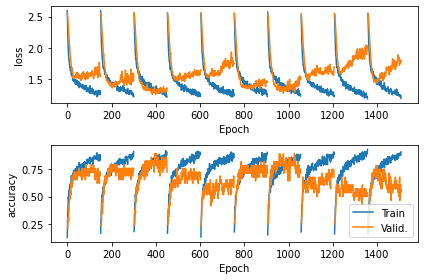

In [13]:
from indl.metrics import quickplot_history

history, accuracy = get_hists_acc(sess_id_old,rules, verbose=2)
quickplot_history(history)

In [22]:
hidden_states = []
# fixed_points = []

for i in range(N_SPLITS):
#     print(f'Working on Split #{i}, new data')
#     model = tf.keras.models.load_model(f'r2c_lstm_sra3_1_j_050_00+_split{i}.h5')
#     lstm = model.layers[10].get_weights()
#     output = model.layers[9].output
#     factor_model = tf.keras.Model(model.input, output)
#     factors = factor_model(X_rates)
#     inputs = tf.keras.layers.Input(shape=factors.shape[1:])
#     state_lstm = tf.keras.layers.LSTM(model_kwargs['n_rnn'],
#                                       kernel_regularizer=tf.keras.regularizers.l2(model_kwargs['l2_reg']),
#                                       recurrent_regularizer=tf.keras.regularizers.l2(model_kwargs['l2_reg']),
#                                       return_sequences=True,
#                                       name='state_rnn1')(inputs)
#     state_model = tf.keras.Model(inputs, state_lstm)
#     state_model.layers[-1].set_weights(lstm)
#     state_outputs = state_model(factors)
    
#     pca = PCA(n_components=2)
#     tmp = np.reshape(state_outputs, (state_outputs.shape[0] * state_outputs.shape[1], state_outputs.shape[2]))
#     st_out_pc = pca.fit_transform(tmp)
#     tmp = np.reshape(st_out_pc, (state_outputs.shape[0], state_outputs.shape[1], st_out_pc.shape[1]))
#     hidden_states.append(tmp)
    
#     tmp = fxpts_list[2*i].T
#     tmp = pca.transform(tmp)
#     fixed_points.append(tmp.T)
    
    print(f'Working on Split #{i}, old data')
    model = tf.keras.models.load_model(f'r2c_lstm_sra3_1_j_050_00_v1+old_split{i}.h5')
    lstm = model.layers[10].get_weights()
    output = model.layers[9].output
    factor_model = tf.keras.Model(model.input, output)
    factors = factor_model(X_rates)
    inputs = tf.keras.layers.Input(shape=factors.shape[1:])
    state_lstm = tf.keras.layers.LSTM(model_kwargs['n_rnn'],
                                      kernel_regularizer=tf.keras.regularizers.l2(model_kwargs['l2_reg']),
                                      recurrent_regularizer=tf.keras.regularizers.l2(model_kwargs['l2_reg']),
                                      return_sequences=True,
                                      name='state_rnn1')(inputs)
    state_model = tf.keras.Model(inputs, state_lstm)

    state_model.layers[-1].set_weights(lstm)
    state_outputs = state_model(factors)
    
    tmp = np.reshape(state_outputs, (state_outputs.shape[0] * state_outputs.shape[1], state_outputs.shape[2]))
    fa_values = FactorAnalysis(n_components=10, random_state=0).fit_transform(tmp)
#     pca_values = PCA(n_components=2).fit_transform(fa_values)
#     tsne_values = TSNE(n_components=3,perplexity=10).fit_transform(pca_values)
    tmp = np.reshape(fa_values, (state_outputs.shape[0], state_outputs.shape[1], fa_values.shape[1]))
    hidden_states.append(tmp)

Working on Split #0, old data
Working on Split #1, old data
Working on Split #2, old data
Working on Split #3, old data
Working on Split #4, old data
Working on Split #5, old data
Working on Split #6, old data
Working on Split #7, old data
Working on Split #8, old data
Working on Split #9, old data


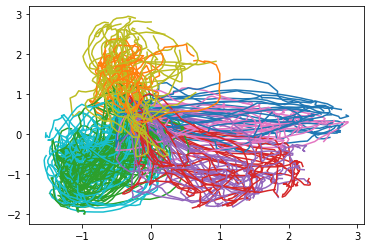

In [23]:
color_map = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:pink', 'tab:olive', 'tab:cyan', 'tab:purple']
for j in range(len(hidden_states[3])):
    plt.plot(hidden_states[3][j, :, 0], hidden_states[3][j, :, 1], color_map[int(Y[j])])

# Rule Model

In [53]:
from indl.model import parts
from indl.model.helper import check_inputs
from indl.regularizers import KernelLengthRegularizer

@check_inputs
def make_model(
    _input,
    num_classes,
    filt=8,
    kernLength=25,
    ds_rate=10,
    n_rnn=64,
    n_rnn2=64,
    dropoutRate=0.25,
    activation='relu',
    l1_reg=0.000, l2_reg=0.000,
    norm_rate=0.25,
    latent_dim=16,
    return_model=True
):
    
    inputs = _input
    
    input_shape = _input.shape.as_list()
    # The Conv layers are insensitive to the number of samples in the time dimension.
    # To make it possible for this trained model to be applied to segments of different
    # durations, we need to explicitly state that we don't care about the number of samples.
    # input_shape[2] = -1  # Comment out during debug
    # _y = layers.Reshape(input_shape[1:])(_input)  # Note that Reshape ignores the batch dimension.

    # RNN
    if len(input_shape) < 4:
        input_shape = input_shape + [1]
    # The Conv layers are insensitive to the number of samples in the time dimension.
    # To make it possible for this trained model to be applied to segments of different
    # durations, we need to explicitly state that we don't care about the number of samples.
    _y = tf.keras.layers.Reshape(input_shape[1:])(inputs)
    _y = tf.keras.layers.Conv2D(filt, (1, kernLength), padding='valid', data_format=None,
                                dilation_rate=(1, 1), activation=None, use_bias=True, kernel_initializer='glorot_uniform',
                                bias_initializer='zeros', kernel_regularizer=None, bias_regularizer=None,
                                activity_regularizer=None, kernel_constraint=None, bias_constraint=None)(_y)
    _y = tf.keras.layers.BatchNormalization()(_y)
    _y = tf.keras.layers.DepthwiseConv2D((_y.shape.as_list()[1], 1), padding='valid',
                                      depth_multiplier=1, data_format=None, dilation_rate=(1, 1),
                                      activation=None, use_bias=True, depthwise_initializer='glorot_uniform',
                                      bias_initializer='zeros', depthwise_regularizer=None,
                                      bias_regularizer=None, activity_regularizer=None,
                                      depthwise_constraint=None, bias_constraint=None)(_y)
    _y = tf.keras.layers.BatchNormalization()(_y)
    _y = tf.keras.layers.Activation(activation)(_y)
#     _y = tf.keras.layers.AveragePooling2D(pool_size=(1, ds_rate))(_y)
    _y = tf.keras.layers.Dropout(dropoutRate)(_y)
    _y = tf.keras.layers.Reshape(_y.shape.as_list()[2:])(_y)
    _y = tf.keras.layers.LSTM(n_rnn,
                              kernel_regularizer=tf.keras.regularizers.l2(l2_reg),
                              recurrent_regularizer=tf.keras.regularizers.l2(l2_reg),
                              return_sequences=n_rnn2 > 0,
                              stateful=False,
                              name='rnn1')(_y)
    _y = tf.keras.layers.Activation(activation)(_y)
    _y = tf.keras.layers.BatchNormalization()(_y)
    _y = tf.keras.layers.Dropout(dropoutRate)(_y)
    
    
    if n_rnn2 > 0:
        
        _y = tf.keras.layers.LSTM(n_rnn2,
                              kernel_regularizer=tf.keras.regularizers.l2(l2_reg),
                              recurrent_regularizer=tf.keras.regularizers.l2(l2_reg),
                              return_sequences=False,
                              stateful=False,
                              name='rnn2')(_y)
        _y = tf.keras.layers.Activation(activation)(_y)
        _y = tf.keras.layers.BatchNormalization()(_y)
        _y = tf.keras.layers.Dropout(dropoutRate)(_y)
    
    # Dense
    _y = parts.Bottleneck(_y, latent_dim=latent_dim, activation=activation)
    
    # Classify
    outputs = parts.Classify(_y, n_classes=num_classes, norm_rate=norm_rate)
    

    if return_model is False:
        return outputs
    else:
        return tf.keras.models.Model(inputs=inputs, outputs=outputs)


def get_hists_acc(sess_id, _x, _rule, name, verbose=1):
    print(f"Processing session {sess_id}...")
    
    splitter = StratifiedKFold(n_splits=N_SPLITS, shuffle=True, random_state=0)
    split_ix = 0
    histories = []
    per_fold_eval = []
    per_fold_true = []

    for trn, vld in splitter.split(_x, _rule):
        print(f"\tSplit {split_ix + 1} of {N_SPLITS}")
        _y = tf.keras.utils.to_categorical(_rule, num_classes=len(np.unique(_rule)))
        
        ds_train = tf.data.Dataset.from_tensor_slices((_x[trn], _y[trn]))
        ds_valid = tf.data.Dataset.from_tensor_slices((_x[vld], _y[vld]))

        # cast data types to GPU-friendly types.
        ds_train = ds_train.map(lambda x, y: (tf.cast(x, tf.float32), tf.cast(y, tf.uint8)))
        ds_valid = ds_valid.map(lambda x, y: (tf.cast(x, tf.float32), tf.cast(y, tf.uint8)))

        # TODO: augmentations (random slicing?)

        ds_train = ds_train.shuffle(len(trn) + 1)
        ds_train = ds_train.batch(BATCH_SIZE, drop_remainder=True)
        ds_valid = ds_valid.batch(BATCH_SIZE, drop_remainder=False)

        tf.keras.backend.clear_session()
        
        randseed = 12345
        random.seed(randseed)
        np.random.seed(randseed)
        tf.random.set_seed(randseed)
        
        model = make_model(
            ds_train.element_spec[0],
            _y.shape[-1],
            **model_kwargs
        )
        optim = tf.keras.optimizers.Nadam(learning_rate=0.001)
        loss_obj = tf.keras.losses.CategoricalCrossentropy(label_smoothing=LABEL_SMOOTHING)
        model.compile(optimizer=optim, loss=loss_obj, metrics=['accuracy'])
        
        best_model_path = f'{name}_{sess_id}old_split{split_ix}.h5'
        callbacks = [
            tf.keras.callbacks.ModelCheckpoint(
                filepath=best_model_path,
                # Path where to save the model
                # The two parameters below mean that we will overwrite
                # the current checkpoint if and only if
                # the `val_loss` score has improved.
                save_best_only=True,
                monitor='val_accuracy',
                verbose=verbose)
        ]

        hist = model.fit(x=ds_train, epochs=EPOCHS,
                         verbose=verbose,
                         validation_data=ds_valid,
                         callbacks=callbacks)
        # tf.keras.models.save_model(model, 'model.h5')
        histories.append(hist.history)
        
        model = tf.keras.models.load_model(best_model_path)
        per_fold_eval.append(model(X_rates[vld]).numpy())
        per_fold_true.append(Y_class[vld])
        
        split_ix += 1
        
    # Combine histories into one dictionary.
    history = {}
    for h in histories:
        for k,v in h.items():
            if k not in history:
                history[k] = v
            else:
                history[k].append(np.nan)
                history[k].extend(v)
                
    pred_y = np.concatenate([np.argmax(_, axis=1) for _ in per_fold_eval])
    true_y = np.concatenate(per_fold_true).flatten()
    accuracy = 100 * np.sum(pred_y == true_y) / len(pred_y)
    print(f"Session {sess_id} overall accuracy: {accuracy}%")
    
    return history, accuracy

In [134]:
test_sess_ix = 1
sess_info = sess_infos[test_sess_ix]
sess_id = sess_info['exp_code']
sess_id = sess_id.replace("+", "")+"_v1"
segmented_path = data_path / (sess_id + '_segmented.h5')

segmented_data = from_neuropype_h5(segmented_path)
outcome = np.array(segmented_data[2][1]['axes'][0]['data']['OutcomeCode'])
flag = np.argwhere(outcome>-1).flatten()
outcome = outcome[flag]
Y = np.array(segmented_data[2][1]['axes'][0]['data']['TargetClass']).flatten()[flag]
Y_class = tf.keras.utils.to_categorical(Y, num_classes=8)
X_rates = segmented_data[2][1]['data'][flag]
X_rates = np.nan_to_num(X_rates)
X_rates = np.transpose(X_rates, (0, 2, 1))
block = np.array(segmented_data[2][1]['axes'][0]['data']['Block']).flatten()[flag]
b=np.diff(block, axis=0)
border=np.array(np.where(b>0)).flatten()
to_keep = [0]
for i in range(len(border)-1):
    if (border[i+1] - border[i]) > 30 and (len(outcome)-border[i+1]) > 30:
        to_keep.append(i+1)
border = border[to_keep]
color = np.array(segmented_data[2][1]['axes'][0]['data']['CueColour']).flatten()[flag]
target = np.array(segmented_data[2][1]['axes'][0]['data']['TargetRule']).flatten()[flag]
classes = np.array(segmented_data[2][1]['axes'][0]['data']['TargetClass']).flatten()[flag]

print(border)
print(sess_id)
print(outcome.shape)
print(X_rates.shape, Y.shape, np.unique(Y, return_counts=True))

[ 72 145 177 276 422 476 516 565 602]
sra3_1_j_050_00_v1
(663,)
(663, 32, 207) (663,) (array([0, 1, 2, 3, 4, 5, 6, 7]), array([ 83,  75, 100,  58,  70, 115,  97,  65], dtype=int64))


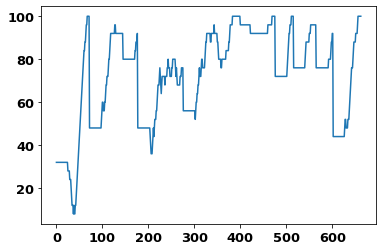

In [36]:
m_performance = np.zeros(len(outcome))
cor = 0
b=0
tot = 25
for i in range(tot):
    if outcome[i]==0:
        cor += 1

m_performance[:tot] = 100 * (cor / tot)
# for i in range(tot, len(outcome)):
i = tot
while i<len(outcome):
    if i == border[b]:
        cor = 0
        for j in range(tot):
            if outcome[i+j]==0:
                cor += 1
        m_performance[i:i+tot] = 100 * (cor / tot)
        i += tot
        b = (b+1)%len(border)
    elif outcome[i] == outcome[i-tot]:
        m_performance[i] = m_performance[i-1]
        i += 1
    elif outcome[i]==0:
        cor += 1
        m_performance[i] = 100 * (cor / tot)
        i += 1
    else:
        cor -= 1
        m_performance[i] = 100 * (cor / tot)
        i +=1

for i in range(len(m_performance)):
    if m_performance[i]<0:
        m_performance[i] = 0
plt.plot(m_performance)
learned = np.argwhere(m_performance>70).flatten()
unlearned = np.argwhere(m_performance<60).flatten()

In [135]:
rule = np.zeros(np.size(X_rates,0))
for i in range(len(rule)):
    if (target[i]=='UU'):
        if (color[i] == 'r'):
            rule[i]=0
        elif(color[i] == 'g'):
            rule[i]=1
        else:
            rule[i]=2
    elif (target[i]=='UR'):
        if (color[i] == 'r'):
            rule[i]=3
        elif(color[i] == 'g'):
            rule[i]=4
        else:
            rule[i]=5
    elif (target[i]=='RR'):
        if (color[i] == 'r'):
            rule[i]=6
        elif(color[i] == 'g'):
            rule[i]=7
        else:
            rule[i]=8
    elif (target[i]=='DR'):
        if (color[i] == 'r'):
            rule[i]=9
        elif(color[i] == 'g'):
            rule[i]=10
        else:
            rule[i]=11
    elif (target[i]=='DD'):
        if (color[i] == 'r'):
            rule[i]=12
        elif(color[i] == 'g'):
            rule[i]=13
        else:
            rule[i]=14
    elif (target[i]=='DL'):
        if (color[i] == 'r'):
            rule[i]=15
        elif(color[i] == 'g'):
            rule[i]=16
        else:
            rule[i]=17
    elif (target[i]=='LL'):
        if (color[i] == 'r'):
            rule[i]=18
        elif(color[i] == 'g'):
            rule[i]=19
        else:
            rule[i]=20
    elif (target[i]=='UL'):
        if (color[i] == 'r'):
            rule[i]=21
        elif(color[i] == 'g'):
            rule[i]=22
        else:
            rule[i]=23
rule = rule.astype(int)
print(np.unique(rule, return_counts=True))
rules = np.zeros(len(rule))
unique = np.unique(rule)
for i in range(len(rules)):
    for j in range(len(unique)):
        if rule[i] == unique[j]:
            rules[i] = j
rules = rules.astype(int)
print(np.unique(rules, return_counts=True))
print(rules.shape)
#Manual: ['UUr','UUg','UUb','URr','URg','RRg','DRr','DRg','DDr','DDg','DLr','DLb','LLr','ULb']
#['UUr','UUb','URr','URg','RRg','DRr','DRg','DDg','DLr','DLb','LLr','ULb']

(array([ 0,  1,  2,  3,  4,  7,  9, 10, 12, 13, 15, 17, 18, 23]), array([ 29,   1,  53,  23,  52, 100,  35,  23,   7,  63,  21,  94,  97,
        65], dtype=int64))
(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13]), array([ 29,   1,  53,  23,  52, 100,  35,  23,   7,  63,  21,  94,  97,
        65], dtype=int64))
(663,)


Processing session sra3_1_j_050_00_v1...
	Split 1 of 10
Epoch 1/150

Epoch 00001: val_accuracy improved from -inf to 0.20455, saving model to lr2r_sra3_1_j_050_00_v1old_split0.h5
24/24 - 1s - loss: 2.6145 - accuracy: 0.1302 - val_loss: 2.6016 - val_accuracy: 0.2045
Epoch 2/150

Epoch 00002: val_accuracy improved from 0.20455 to 0.22727, saving model to lr2r_sra3_1_j_050_00_v1old_split0.h5
24/24 - 1s - loss: 2.4972 - accuracy: 0.2109 - val_loss: 2.5698 - val_accuracy: 0.2273
Epoch 3/150

Epoch 00003: val_accuracy improved from 0.22727 to 0.25000, saving model to lr2r_sra3_1_j_050_00_v1old_split0.h5
24/24 - 1s - loss: 2.3931 - accuracy: 0.3021 - val_loss: 2.5248 - val_accuracy: 0.2500
Epoch 4/150

Epoch 00004: val_accuracy improved from 0.25000 to 0.29545, saving model to lr2r_sra3_1_j_050_00_v1old_split0.h5
24/24 - 1s - loss: 2.2901 - accuracy: 0.3359 - val_loss: 2.4596 - val_accuracy: 0.2955
Epoch 5/150

Epoch 00005: val_accuracy did not improve from 0.29545
24/24 - 1s - loss: 2.1748 -

Epoch 49/150

Epoch 00049: val_accuracy did not improve from 0.84091
24/24 - 1s - loss: 1.5022 - accuracy: 0.7526 - val_loss: 1.4170 - val_accuracy: 0.7500
Epoch 50/150

Epoch 00050: val_accuracy did not improve from 0.84091
24/24 - 1s - loss: 1.5115 - accuracy: 0.7604 - val_loss: 1.4009 - val_accuracy: 0.7955
Epoch 51/150

Epoch 00051: val_accuracy did not improve from 0.84091
24/24 - 1s - loss: 1.5141 - accuracy: 0.7760 - val_loss: 1.3708 - val_accuracy: 0.7955
Epoch 52/150

Epoch 00052: val_accuracy did not improve from 0.84091
24/24 - 1s - loss: 1.5099 - accuracy: 0.7865 - val_loss: 1.3918 - val_accuracy: 0.7727
Epoch 53/150

Epoch 00053: val_accuracy did not improve from 0.84091
24/24 - 1s - loss: 1.4996 - accuracy: 0.7708 - val_loss: 1.4079 - val_accuracy: 0.8182
Epoch 54/150

Epoch 00054: val_accuracy did not improve from 0.84091
24/24 - 1s - loss: 1.5015 - accuracy: 0.7786 - val_loss: 1.3805 - val_accuracy: 0.8409
Epoch 55/150

Epoch 00055: val_accuracy improved from 0.84091 to

Epoch 102/150

Epoch 00102: val_accuracy did not improve from 0.86364
24/24 - 1s - loss: 1.4538 - accuracy: 0.8021 - val_loss: 1.4371 - val_accuracy: 0.7273
Epoch 103/150

Epoch 00103: val_accuracy did not improve from 0.86364
24/24 - 1s - loss: 1.4224 - accuracy: 0.8047 - val_loss: 1.3976 - val_accuracy: 0.7955
Epoch 104/150

Epoch 00104: val_accuracy did not improve from 0.86364
24/24 - 1s - loss: 1.3888 - accuracy: 0.8359 - val_loss: 1.3986 - val_accuracy: 0.7727
Epoch 105/150

Epoch 00105: val_accuracy did not improve from 0.86364
24/24 - 1s - loss: 1.4278 - accuracy: 0.7995 - val_loss: 1.3676 - val_accuracy: 0.8182
Epoch 106/150

Epoch 00106: val_accuracy did not improve from 0.86364
24/24 - 1s - loss: 1.4210 - accuracy: 0.8073 - val_loss: 1.3700 - val_accuracy: 0.8409
Epoch 107/150

Epoch 00107: val_accuracy did not improve from 0.86364
24/24 - 1s - loss: 1.4237 - accuracy: 0.8203 - val_loss: 1.3984 - val_accuracy: 0.7500
Epoch 108/150

Epoch 00108: val_accuracy did not improve f

Epoch 4/150

Epoch 00004: val_accuracy improved from 0.22727 to 0.29545, saving model to lr2r_sra3_1_j_050_00_v1old_split1.h5
24/24 - 1s - loss: 2.2998 - accuracy: 0.3568 - val_loss: 2.4670 - val_accuracy: 0.2955
Epoch 5/150

Epoch 00005: val_accuracy did not improve from 0.29545
24/24 - 1s - loss: 2.2082 - accuracy: 0.3958 - val_loss: 2.3945 - val_accuracy: 0.2955
Epoch 6/150

Epoch 00006: val_accuracy did not improve from 0.29545
24/24 - 1s - loss: 2.1276 - accuracy: 0.3932 - val_loss: 2.3084 - val_accuracy: 0.2727
Epoch 7/150

Epoch 00007: val_accuracy improved from 0.29545 to 0.34091, saving model to lr2r_sra3_1_j_050_00_v1old_split1.h5
24/24 - 1s - loss: 2.0572 - accuracy: 0.4583 - val_loss: 2.2364 - val_accuracy: 0.3409
Epoch 8/150

Epoch 00008: val_accuracy improved from 0.34091 to 0.36364, saving model to lr2r_sra3_1_j_050_00_v1old_split1.h5
24/24 - 1s - loss: 1.9818 - accuracy: 0.5234 - val_loss: 2.1907 - val_accuracy: 0.3636
Epoch 9/150

Epoch 00009: val_accuracy improved fro

Epoch 53/150

Epoch 00053: val_accuracy did not improve from 0.77273
24/24 - 1s - loss: 1.4668 - accuracy: 0.7656 - val_loss: 1.4268 - val_accuracy: 0.7273
Epoch 54/150

Epoch 00054: val_accuracy did not improve from 0.77273
24/24 - 1s - loss: 1.4939 - accuracy: 0.7578 - val_loss: 1.4222 - val_accuracy: 0.7500
Epoch 55/150

Epoch 00055: val_accuracy did not improve from 0.77273
24/24 - 1s - loss: 1.4899 - accuracy: 0.7708 - val_loss: 1.4215 - val_accuracy: 0.7045
Epoch 56/150

Epoch 00056: val_accuracy did not improve from 0.77273
24/24 - 1s - loss: 1.4691 - accuracy: 0.7865 - val_loss: 1.4524 - val_accuracy: 0.7045
Epoch 57/150

Epoch 00057: val_accuracy did not improve from 0.77273
24/24 - 1s - loss: 1.4881 - accuracy: 0.8047 - val_loss: 1.4229 - val_accuracy: 0.7500
Epoch 58/150

Epoch 00058: val_accuracy did not improve from 0.77273
24/24 - 1s - loss: 1.4407 - accuracy: 0.8047 - val_loss: 1.4092 - val_accuracy: 0.7273
Epoch 59/150

Epoch 00059: val_accuracy did not improve from 0.7

Epoch 106/150

Epoch 00106: val_accuracy did not improve from 0.79545
24/24 - 1s - loss: 1.4169 - accuracy: 0.8229 - val_loss: 1.4437 - val_accuracy: 0.7045
Epoch 107/150

Epoch 00107: val_accuracy did not improve from 0.79545
24/24 - 1s - loss: 1.4618 - accuracy: 0.7786 - val_loss: 1.4740 - val_accuracy: 0.7500
Epoch 108/150

Epoch 00108: val_accuracy did not improve from 0.79545
24/24 - 1s - loss: 1.3832 - accuracy: 0.8255 - val_loss: 1.4484 - val_accuracy: 0.7045
Epoch 109/150

Epoch 00109: val_accuracy did not improve from 0.79545
24/24 - 1s - loss: 1.4109 - accuracy: 0.8281 - val_loss: 1.4248 - val_accuracy: 0.7273
Epoch 110/150

Epoch 00110: val_accuracy did not improve from 0.79545
24/24 - 1s - loss: 1.3852 - accuracy: 0.8229 - val_loss: 1.4965 - val_accuracy: 0.7045
Epoch 111/150

Epoch 00111: val_accuracy did not improve from 0.79545
24/24 - 1s - loss: 1.4181 - accuracy: 0.8177 - val_loss: 1.4295 - val_accuracy: 0.7045
Epoch 112/150

Epoch 00112: val_accuracy did not improve f

Epoch 7/150

Epoch 00007: val_accuracy improved from 0.43182 to 0.45455, saving model to lr2r_sra3_1_j_050_00_v1old_split2.h5
24/24 - 1s - loss: 2.0516 - accuracy: 0.4661 - val_loss: 2.2534 - val_accuracy: 0.4545
Epoch 8/150

Epoch 00008: val_accuracy did not improve from 0.45455
24/24 - 1s - loss: 1.9780 - accuracy: 0.5156 - val_loss: 2.1739 - val_accuracy: 0.4545
Epoch 9/150

Epoch 00009: val_accuracy improved from 0.45455 to 0.47727, saving model to lr2r_sra3_1_j_050_00_v1old_split2.h5
24/24 - 1s - loss: 1.9707 - accuracy: 0.5156 - val_loss: 2.0995 - val_accuracy: 0.4773
Epoch 10/150

Epoch 00010: val_accuracy improved from 0.47727 to 0.54545, saving model to lr2r_sra3_1_j_050_00_v1old_split2.h5
24/24 - 1s - loss: 1.9158 - accuracy: 0.5365 - val_loss: 2.0110 - val_accuracy: 0.5455
Epoch 11/150

Epoch 00011: val_accuracy did not improve from 0.54545
24/24 - 1s - loss: 1.8586 - accuracy: 0.5755 - val_loss: 1.9014 - val_accuracy: 0.5455
Epoch 12/150

Epoch 00012: val_accuracy improved 

Epoch 56/150

Epoch 00056: val_accuracy did not improve from 0.84091
24/24 - 1s - loss: 1.5494 - accuracy: 0.7318 - val_loss: 1.4174 - val_accuracy: 0.7727
Epoch 57/150

Epoch 00057: val_accuracy did not improve from 0.84091
24/24 - 1s - loss: 1.5196 - accuracy: 0.7292 - val_loss: 1.4165 - val_accuracy: 0.7955
Epoch 58/150

Epoch 00058: val_accuracy did not improve from 0.84091
24/24 - 1s - loss: 1.4630 - accuracy: 0.7734 - val_loss: 1.4321 - val_accuracy: 0.7955
Epoch 59/150

Epoch 00059: val_accuracy did not improve from 0.84091
24/24 - 1s - loss: 1.4931 - accuracy: 0.7318 - val_loss: 1.4252 - val_accuracy: 0.7955
Epoch 60/150

Epoch 00060: val_accuracy did not improve from 0.84091
24/24 - 1s - loss: 1.4799 - accuracy: 0.7630 - val_loss: 1.3899 - val_accuracy: 0.8182
Epoch 61/150

Epoch 00061: val_accuracy did not improve from 0.84091
24/24 - 1s - loss: 1.4918 - accuracy: 0.7708 - val_loss: 1.4232 - val_accuracy: 0.7955
Epoch 62/150

Epoch 00062: val_accuracy did not improve from 0.8

Epoch 109/150

Epoch 00109: val_accuracy did not improve from 0.84091
24/24 - 1s - loss: 1.4624 - accuracy: 0.7891 - val_loss: 1.3877 - val_accuracy: 0.8182
Epoch 110/150

Epoch 00110: val_accuracy did not improve from 0.84091
24/24 - 1s - loss: 1.4352 - accuracy: 0.8125 - val_loss: 1.3704 - val_accuracy: 0.8409
Epoch 111/150

Epoch 00111: val_accuracy did not improve from 0.84091
24/24 - 1s - loss: 1.3942 - accuracy: 0.8151 - val_loss: 1.3805 - val_accuracy: 0.7955
Epoch 112/150

Epoch 00112: val_accuracy did not improve from 0.84091
24/24 - 1s - loss: 1.4156 - accuracy: 0.7969 - val_loss: 1.3865 - val_accuracy: 0.7727
Epoch 113/150

Epoch 00113: val_accuracy did not improve from 0.84091
24/24 - 1s - loss: 1.4194 - accuracy: 0.8281 - val_loss: 1.3858 - val_accuracy: 0.8182
Epoch 114/150

Epoch 00114: val_accuracy did not improve from 0.84091
24/24 - 1s - loss: 1.3940 - accuracy: 0.8203 - val_loss: 1.3970 - val_accuracy: 0.7955
Epoch 115/150

Epoch 00115: val_accuracy did not improve f

Epoch 10/150

Epoch 00010: val_accuracy improved from 0.45455 to 0.56818, saving model to lr2r_sra3_1_j_050_00_v1old_split3.h5
24/24 - 1s - loss: 1.8928 - accuracy: 0.5521 - val_loss: 2.0372 - val_accuracy: 0.5682
Epoch 11/150

Epoch 00011: val_accuracy improved from 0.56818 to 0.61364, saving model to lr2r_sra3_1_j_050_00_v1old_split3.h5
24/24 - 1s - loss: 1.8344 - accuracy: 0.5755 - val_loss: 1.9422 - val_accuracy: 0.6136
Epoch 12/150

Epoch 00012: val_accuracy did not improve from 0.61364
24/24 - 1s - loss: 1.8325 - accuracy: 0.5833 - val_loss: 1.9531 - val_accuracy: 0.5227
Epoch 13/150

Epoch 00013: val_accuracy did not improve from 0.61364
24/24 - 1s - loss: 1.8419 - accuracy: 0.5339 - val_loss: 1.8998 - val_accuracy: 0.5227
Epoch 14/150

Epoch 00014: val_accuracy did not improve from 0.61364
24/24 - 1s - loss: 1.8326 - accuracy: 0.5859 - val_loss: 1.8003 - val_accuracy: 0.6136
Epoch 15/150

Epoch 00015: val_accuracy improved from 0.61364 to 0.70455, saving model to lr2r_sra3_1_j_

Epoch 60/150

Epoch 00060: val_accuracy did not improve from 0.79545
24/24 - 1s - loss: 1.4592 - accuracy: 0.7812 - val_loss: 1.4650 - val_accuracy: 0.7727
Epoch 61/150

Epoch 00061: val_accuracy did not improve from 0.79545
24/24 - 1s - loss: 1.4640 - accuracy: 0.7969 - val_loss: 1.4920 - val_accuracy: 0.7500
Epoch 62/150

Epoch 00062: val_accuracy did not improve from 0.79545
24/24 - 1s - loss: 1.4545 - accuracy: 0.7734 - val_loss: 1.4680 - val_accuracy: 0.7500
Epoch 63/150

Epoch 00063: val_accuracy did not improve from 0.79545
24/24 - 1s - loss: 1.4432 - accuracy: 0.7969 - val_loss: 1.4613 - val_accuracy: 0.7500
Epoch 64/150

Epoch 00064: val_accuracy did not improve from 0.79545
24/24 - 1s - loss: 1.4668 - accuracy: 0.7682 - val_loss: 1.4562 - val_accuracy: 0.7500
Epoch 65/150

Epoch 00065: val_accuracy did not improve from 0.79545
24/24 - 1s - loss: 1.4488 - accuracy: 0.7917 - val_loss: 1.4380 - val_accuracy: 0.7955
Epoch 66/150

Epoch 00066: val_accuracy did not improve from 0.7


Epoch 00112: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.4535 - accuracy: 0.7969 - val_loss: 1.5070 - val_accuracy: 0.7500
Epoch 113/150

Epoch 00113: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.4121 - accuracy: 0.8021 - val_loss: 1.5360 - val_accuracy: 0.7500
Epoch 114/150

Epoch 00114: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.3909 - accuracy: 0.8229 - val_loss: 1.4624 - val_accuracy: 0.7727
Epoch 115/150

Epoch 00115: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.3852 - accuracy: 0.8438 - val_loss: 1.5011 - val_accuracy: 0.7273
Epoch 116/150

Epoch 00116: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.3939 - accuracy: 0.8281 - val_loss: 1.4409 - val_accuracy: 0.7727
Epoch 117/150

Epoch 00117: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.4012 - accuracy: 0.8255 - val_loss: 1.4409 - val_accuracy: 0.7727
Epoch 118/150

Epoch 00118: val_accuracy did not improve from 0.81818
24

Epoch 12/150

Epoch 00012: val_accuracy improved from 0.56818 to 0.65909, saving model to lr2r_sra3_1_j_050_00_v1old_split4.h5
24/24 - 1s - loss: 1.8006 - accuracy: 0.5755 - val_loss: 1.8415 - val_accuracy: 0.6591
Epoch 13/150

Epoch 00013: val_accuracy did not improve from 0.65909
24/24 - 1s - loss: 1.7846 - accuracy: 0.6172 - val_loss: 1.7856 - val_accuracy: 0.6364
Epoch 14/150

Epoch 00014: val_accuracy did not improve from 0.65909
24/24 - 1s - loss: 1.7918 - accuracy: 0.6276 - val_loss: 1.7394 - val_accuracy: 0.6136
Epoch 15/150

Epoch 00015: val_accuracy improved from 0.65909 to 0.68182, saving model to lr2r_sra3_1_j_050_00_v1old_split4.h5
24/24 - 1s - loss: 1.7398 - accuracy: 0.6354 - val_loss: 1.7357 - val_accuracy: 0.6818
Epoch 16/150

Epoch 00016: val_accuracy did not improve from 0.68182
24/24 - 1s - loss: 1.7399 - accuracy: 0.6432 - val_loss: 1.6856 - val_accuracy: 0.6591
Epoch 17/150

Epoch 00017: val_accuracy improved from 0.68182 to 0.70455, saving model to lr2r_sra3_1_j_

Epoch 62/150

Epoch 00062: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.4720 - accuracy: 0.7604 - val_loss: 1.4753 - val_accuracy: 0.7045
Epoch 63/150

Epoch 00063: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.4812 - accuracy: 0.7812 - val_loss: 1.4384 - val_accuracy: 0.7727
Epoch 64/150

Epoch 00064: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.4667 - accuracy: 0.7786 - val_loss: 1.4753 - val_accuracy: 0.7273
Epoch 65/150

Epoch 00065: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.4877 - accuracy: 0.7760 - val_loss: 1.5636 - val_accuracy: 0.7045
Epoch 66/150

Epoch 00066: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.4733 - accuracy: 0.7734 - val_loss: 1.5006 - val_accuracy: 0.6818
Epoch 67/150

Epoch 00067: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.4857 - accuracy: 0.7474 - val_loss: 1.5187 - val_accuracy: 0.7045
Epoch 68/150

Epoch 00068: val_accuracy did not improve from 0.8

Epoch 115/150

Epoch 00115: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.4267 - accuracy: 0.8255 - val_loss: 1.4729 - val_accuracy: 0.7273
Epoch 116/150

Epoch 00116: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.3705 - accuracy: 0.8333 - val_loss: 1.4754 - val_accuracy: 0.7273
Epoch 117/150

Epoch 00117: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.3690 - accuracy: 0.8464 - val_loss: 1.4413 - val_accuracy: 0.7500
Epoch 118/150

Epoch 00118: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.3974 - accuracy: 0.8281 - val_loss: 1.4665 - val_accuracy: 0.7273
Epoch 119/150

Epoch 00119: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.3920 - accuracy: 0.8255 - val_loss: 1.5133 - val_accuracy: 0.7045
Epoch 120/150

Epoch 00120: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.4110 - accuracy: 0.8281 - val_loss: 1.4683 - val_accuracy: 0.7500
Epoch 121/150

Epoch 00121: val_accuracy did not improve f

Epoch 14/150

Epoch 00014: val_accuracy improved from 0.63636 to 0.70455, saving model to lr2r_sra3_1_j_050_00_v1old_split5.h5
24/24 - 1s - loss: 1.7785 - accuracy: 0.6172 - val_loss: 1.7101 - val_accuracy: 0.7045
Epoch 15/150

Epoch 00015: val_accuracy improved from 0.70455 to 0.72727, saving model to lr2r_sra3_1_j_050_00_v1old_split5.h5
24/24 - 1s - loss: 1.7688 - accuracy: 0.6094 - val_loss: 1.6627 - val_accuracy: 0.7273
Epoch 16/150

Epoch 00016: val_accuracy did not improve from 0.72727
24/24 - 1s - loss: 1.7323 - accuracy: 0.6172 - val_loss: 1.6136 - val_accuracy: 0.7045
Epoch 17/150

Epoch 00017: val_accuracy did not improve from 0.72727
24/24 - 1s - loss: 1.7031 - accuracy: 0.6510 - val_loss: 1.6088 - val_accuracy: 0.6818
Epoch 18/150

Epoch 00018: val_accuracy did not improve from 0.72727
24/24 - 1s - loss: 1.6850 - accuracy: 0.6510 - val_loss: 1.5948 - val_accuracy: 0.7045
Epoch 19/150

Epoch 00019: val_accuracy did not improve from 0.72727
24/24 - 1s - loss: 1.7100 - accurac


Epoch 00065: val_accuracy did not improve from 0.77273
24/24 - 1s - loss: 1.4986 - accuracy: 0.7448 - val_loss: 1.3921 - val_accuracy: 0.7273
Epoch 66/150

Epoch 00066: val_accuracy did not improve from 0.77273
24/24 - 1s - loss: 1.4906 - accuracy: 0.7526 - val_loss: 1.3910 - val_accuracy: 0.7500
Epoch 67/150

Epoch 00067: val_accuracy did not improve from 0.77273
24/24 - 1s - loss: 1.5323 - accuracy: 0.7396 - val_loss: 1.3945 - val_accuracy: 0.7273
Epoch 68/150

Epoch 00068: val_accuracy did not improve from 0.77273
24/24 - 1s - loss: 1.5299 - accuracy: 0.7552 - val_loss: 1.4234 - val_accuracy: 0.7273
Epoch 69/150

Epoch 00069: val_accuracy did not improve from 0.77273
24/24 - 1s - loss: 1.5665 - accuracy: 0.7057 - val_loss: 1.4079 - val_accuracy: 0.7273
Epoch 70/150

Epoch 00070: val_accuracy did not improve from 0.77273
24/24 - 1s - loss: 1.4914 - accuracy: 0.7500 - val_loss: 1.4217 - val_accuracy: 0.7273
Epoch 71/150

Epoch 00071: val_accuracy did not improve from 0.77273
24/24 - 

Epoch 118/150

Epoch 00118: val_accuracy did not improve from 0.79545
24/24 - 1s - loss: 1.4521 - accuracy: 0.7865 - val_loss: 1.4360 - val_accuracy: 0.7273
Epoch 119/150

Epoch 00119: val_accuracy did not improve from 0.79545
24/24 - 1s - loss: 1.4528 - accuracy: 0.7734 - val_loss: 1.4092 - val_accuracy: 0.7727
Epoch 120/150

Epoch 00120: val_accuracy did not improve from 0.79545
24/24 - 1s - loss: 1.4406 - accuracy: 0.7917 - val_loss: 1.3829 - val_accuracy: 0.7727
Epoch 121/150

Epoch 00121: val_accuracy did not improve from 0.79545
24/24 - 1s - loss: 1.4023 - accuracy: 0.8073 - val_loss: 1.3957 - val_accuracy: 0.7500
Epoch 122/150

Epoch 00122: val_accuracy did not improve from 0.79545
24/24 - 1s - loss: 1.4209 - accuracy: 0.7995 - val_loss: 1.4084 - val_accuracy: 0.7500
Epoch 123/150

Epoch 00123: val_accuracy did not improve from 0.79545
24/24 - 1s - loss: 1.4339 - accuracy: 0.7812 - val_loss: 1.4105 - val_accuracy: 0.7500
Epoch 124/150

Epoch 00124: val_accuracy did not improve f

Epoch 17/150

Epoch 00017: val_accuracy did not improve from 0.75000
24/24 - 1s - loss: 1.7230 - accuracy: 0.6406 - val_loss: 1.6205 - val_accuracy: 0.7273
Epoch 18/150

Epoch 00018: val_accuracy did not improve from 0.75000
24/24 - 1s - loss: 1.7234 - accuracy: 0.6510 - val_loss: 1.6128 - val_accuracy: 0.7273
Epoch 19/150

Epoch 00019: val_accuracy did not improve from 0.75000
24/24 - 1s - loss: 1.7171 - accuracy: 0.6432 - val_loss: 1.5870 - val_accuracy: 0.7273
Epoch 20/150

Epoch 00020: val_accuracy improved from 0.75000 to 0.81818, saving model to lr2r_sra3_1_j_050_00_v1old_split6.h5
24/24 - 1s - loss: 1.6564 - accuracy: 0.6510 - val_loss: 1.5478 - val_accuracy: 0.8182
Epoch 21/150

Epoch 00021: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.6619 - accuracy: 0.6641 - val_loss: 1.5728 - val_accuracy: 0.7727
Epoch 22/150

Epoch 00022: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.6688 - accuracy: 0.6745 - val_loss: 1.5435 - val_accuracy: 0.8182
Epoch 

Epoch 70/150

Epoch 00070: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.4302 - accuracy: 0.8047 - val_loss: 1.4438 - val_accuracy: 0.7500
Epoch 71/150

Epoch 00071: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.4436 - accuracy: 0.8099 - val_loss: 1.4829 - val_accuracy: 0.7273
Epoch 72/150

Epoch 00072: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.4991 - accuracy: 0.7656 - val_loss: 1.4294 - val_accuracy: 0.7500
Epoch 73/150

Epoch 00073: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.4737 - accuracy: 0.7865 - val_loss: 1.4738 - val_accuracy: 0.7500
Epoch 74/150

Epoch 00074: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.4859 - accuracy: 0.7656 - val_loss: 1.4806 - val_accuracy: 0.7727
Epoch 75/150

Epoch 00075: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.4206 - accuracy: 0.8177 - val_loss: 1.4690 - val_accuracy: 0.7727
Epoch 76/150

Epoch 00076: val_accuracy did not improve from 0.8

Epoch 123/150

Epoch 00123: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.4058 - accuracy: 0.8281 - val_loss: 1.5070 - val_accuracy: 0.7727
Epoch 124/150

Epoch 00124: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.3913 - accuracy: 0.8255 - val_loss: 1.5309 - val_accuracy: 0.7727
Epoch 125/150

Epoch 00125: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.3489 - accuracy: 0.8594 - val_loss: 1.5174 - val_accuracy: 0.7955
Epoch 126/150

Epoch 00126: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.3801 - accuracy: 0.8438 - val_loss: 1.4940 - val_accuracy: 0.7955
Epoch 127/150

Epoch 00127: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.3696 - accuracy: 0.8385 - val_loss: 1.5156 - val_accuracy: 0.7727
Epoch 128/150

Epoch 00128: val_accuracy did not improve from 0.81818
24/24 - 1s - loss: 1.3431 - accuracy: 0.8672 - val_loss: 1.5292 - val_accuracy: 0.7727
Epoch 129/150

Epoch 00129: val_accuracy did not improve f

Epoch 22/150

Epoch 00022: val_accuracy did not improve from 0.68182
24/24 - 1s - loss: 1.6927 - accuracy: 0.6380 - val_loss: 1.6697 - val_accuracy: 0.6591
Epoch 23/150

Epoch 00023: val_accuracy did not improve from 0.68182
24/24 - 1s - loss: 1.6339 - accuracy: 0.6823 - val_loss: 1.6637 - val_accuracy: 0.6136
Epoch 24/150

Epoch 00024: val_accuracy did not improve from 0.68182
24/24 - 1s - loss: 1.6535 - accuracy: 0.6797 - val_loss: 1.6332 - val_accuracy: 0.6364
Epoch 25/150

Epoch 00025: val_accuracy did not improve from 0.68182
24/24 - 1s - loss: 1.6239 - accuracy: 0.6797 - val_loss: 1.6034 - val_accuracy: 0.6364
Epoch 26/150

Epoch 00026: val_accuracy did not improve from 0.68182
24/24 - 1s - loss: 1.5885 - accuracy: 0.7031 - val_loss: 1.5694 - val_accuracy: 0.6818
Epoch 27/150

Epoch 00027: val_accuracy improved from 0.68182 to 0.70455, saving model to lr2r_sra3_1_j_050_00_v1old_split7.h5
24/24 - 1s - loss: 1.6294 - accuracy: 0.7057 - val_loss: 1.5382 - val_accuracy: 0.7045
Epoch 

Epoch 74/150

Epoch 00074: val_accuracy did not improve from 0.75000
24/24 - 1s - loss: 1.4791 - accuracy: 0.7760 - val_loss: 1.4697 - val_accuracy: 0.7273
Epoch 75/150

Epoch 00075: val_accuracy did not improve from 0.75000
24/24 - 1s - loss: 1.4151 - accuracy: 0.8125 - val_loss: 1.4595 - val_accuracy: 0.7500
Epoch 76/150

Epoch 00076: val_accuracy did not improve from 0.75000
24/24 - 1s - loss: 1.4423 - accuracy: 0.7839 - val_loss: 1.4349 - val_accuracy: 0.7273
Epoch 77/150

Epoch 00077: val_accuracy did not improve from 0.75000
24/24 - 1s - loss: 1.4739 - accuracy: 0.7760 - val_loss: 1.4536 - val_accuracy: 0.7273
Epoch 78/150

Epoch 00078: val_accuracy did not improve from 0.75000
24/24 - 1s - loss: 1.4433 - accuracy: 0.8125 - val_loss: 1.5192 - val_accuracy: 0.7045
Epoch 79/150

Epoch 00079: val_accuracy did not improve from 0.75000
24/24 - 1s - loss: 1.4365 - accuracy: 0.8073 - val_loss: 1.4706 - val_accuracy: 0.6818
Epoch 80/150

Epoch 00080: val_accuracy did not improve from 0.7

Epoch 127/150

Epoch 00127: val_accuracy did not improve from 0.75000
24/24 - 1s - loss: 1.3923 - accuracy: 0.8281 - val_loss: 1.4760 - val_accuracy: 0.7273
Epoch 128/150

Epoch 00128: val_accuracy did not improve from 0.75000
24/24 - 1s - loss: 1.3665 - accuracy: 0.8438 - val_loss: 1.4907 - val_accuracy: 0.7045
Epoch 129/150

Epoch 00129: val_accuracy did not improve from 0.75000
24/24 - 1s - loss: 1.3807 - accuracy: 0.8333 - val_loss: 1.4795 - val_accuracy: 0.7045
Epoch 130/150

Epoch 00130: val_accuracy did not improve from 0.75000
24/24 - 1s - loss: 1.4085 - accuracy: 0.8047 - val_loss: 1.5000 - val_accuracy: 0.7045
Epoch 131/150

Epoch 00131: val_accuracy did not improve from 0.75000
24/24 - 1s - loss: 1.3589 - accuracy: 0.8307 - val_loss: 1.4918 - val_accuracy: 0.6818
Epoch 132/150

Epoch 00132: val_accuracy did not improve from 0.75000
24/24 - 1s - loss: 1.3834 - accuracy: 0.8438 - val_loss: 1.4977 - val_accuracy: 0.7273
Epoch 133/150

Epoch 00133: val_accuracy did not improve f

Epoch 25/150

Epoch 00025: val_accuracy did not improve from 0.72093
24/24 - 1s - loss: 1.6114 - accuracy: 0.6953 - val_loss: 1.5921 - val_accuracy: 0.6744
Epoch 26/150

Epoch 00026: val_accuracy did not improve from 0.72093
24/24 - 1s - loss: 1.6264 - accuracy: 0.6901 - val_loss: 1.5333 - val_accuracy: 0.7209
Epoch 27/150

Epoch 00027: val_accuracy did not improve from 0.72093
24/24 - 1s - loss: 1.5855 - accuracy: 0.7057 - val_loss: 1.5509 - val_accuracy: 0.6977
Epoch 28/150

Epoch 00028: val_accuracy did not improve from 0.72093
24/24 - 1s - loss: 1.6068 - accuracy: 0.6667 - val_loss: 1.5589 - val_accuracy: 0.6744
Epoch 29/150

Epoch 00029: val_accuracy did not improve from 0.72093
24/24 - 1s - loss: 1.6197 - accuracy: 0.7005 - val_loss: 1.5693 - val_accuracy: 0.6744
Epoch 30/150

Epoch 00030: val_accuracy did not improve from 0.72093
24/24 - 1s - loss: 1.6347 - accuracy: 0.6536 - val_loss: 1.5845 - val_accuracy: 0.7209
Epoch 31/150

Epoch 00031: val_accuracy did not improve from 0.7

Epoch 78/150

Epoch 00078: val_accuracy did not improve from 0.76744
24/24 - 1s - loss: 1.4487 - accuracy: 0.7760 - val_loss: 1.4650 - val_accuracy: 0.7209
Epoch 79/150

Epoch 00079: val_accuracy did not improve from 0.76744
24/24 - 1s - loss: 1.4497 - accuracy: 0.8047 - val_loss: 1.4823 - val_accuracy: 0.7442
Epoch 80/150

Epoch 00080: val_accuracy did not improve from 0.76744
24/24 - 1s - loss: 1.4583 - accuracy: 0.7734 - val_loss: 1.4743 - val_accuracy: 0.7442
Epoch 81/150

Epoch 00081: val_accuracy did not improve from 0.76744
24/24 - 1s - loss: 1.4413 - accuracy: 0.7786 - val_loss: 1.5093 - val_accuracy: 0.7442
Epoch 82/150

Epoch 00082: val_accuracy did not improve from 0.76744
24/24 - 1s - loss: 1.4575 - accuracy: 0.7839 - val_loss: 1.5080 - val_accuracy: 0.7674
Epoch 83/150

Epoch 00083: val_accuracy did not improve from 0.76744
24/24 - 1s - loss: 1.4138 - accuracy: 0.8021 - val_loss: 1.4849 - val_accuracy: 0.7674
Epoch 84/150

Epoch 00084: val_accuracy did not improve from 0.7

Epoch 131/150

Epoch 00131: val_accuracy did not improve from 0.76744
24/24 - 1s - loss: 1.4155 - accuracy: 0.7995 - val_loss: 1.4917 - val_accuracy: 0.7442
Epoch 132/150

Epoch 00132: val_accuracy did not improve from 0.76744
24/24 - 1s - loss: 1.3765 - accuracy: 0.8229 - val_loss: 1.4737 - val_accuracy: 0.7442
Epoch 133/150

Epoch 00133: val_accuracy did not improve from 0.76744
24/24 - 1s - loss: 1.3750 - accuracy: 0.8255 - val_loss: 1.4693 - val_accuracy: 0.7442
Epoch 134/150

Epoch 00134: val_accuracy did not improve from 0.76744
24/24 - 1s - loss: 1.4447 - accuracy: 0.7917 - val_loss: 1.4813 - val_accuracy: 0.7674
Epoch 135/150

Epoch 00135: val_accuracy did not improve from 0.76744
24/24 - 1s - loss: 1.4145 - accuracy: 0.7943 - val_loss: 1.4913 - val_accuracy: 0.7442
Epoch 136/150

Epoch 00136: val_accuracy did not improve from 0.76744
24/24 - 1s - loss: 1.4028 - accuracy: 0.7995 - val_loss: 1.4546 - val_accuracy: 0.7442
Epoch 137/150

Epoch 00137: val_accuracy did not improve f

Epoch 28/150

Epoch 00028: val_accuracy did not improve from 0.76744
24/24 - 1s - loss: 1.6175 - accuracy: 0.6667 - val_loss: 1.5242 - val_accuracy: 0.6744
Epoch 29/150

Epoch 00029: val_accuracy did not improve from 0.76744
24/24 - 1s - loss: 1.6197 - accuracy: 0.6927 - val_loss: 1.5025 - val_accuracy: 0.6977
Epoch 30/150

Epoch 00030: val_accuracy did not improve from 0.76744
24/24 - 1s - loss: 1.6138 - accuracy: 0.6771 - val_loss: 1.4849 - val_accuracy: 0.7209
Epoch 31/150

Epoch 00031: val_accuracy did not improve from 0.76744
24/24 - 1s - loss: 1.5857 - accuracy: 0.7083 - val_loss: 1.4697 - val_accuracy: 0.7209
Epoch 32/150

Epoch 00032: val_accuracy did not improve from 0.76744
24/24 - 1s - loss: 1.5728 - accuracy: 0.7188 - val_loss: 1.4578 - val_accuracy: 0.7674
Epoch 33/150

Epoch 00033: val_accuracy did not improve from 0.76744
24/24 - 1s - loss: 1.6074 - accuracy: 0.7083 - val_loss: 1.4402 - val_accuracy: 0.7442
Epoch 34/150

Epoch 00034: val_accuracy did not improve from 0.7

Epoch 80/150

Epoch 00080: val_accuracy did not improve from 0.83721
24/24 - 1s - loss: 1.4987 - accuracy: 0.7760 - val_loss: 1.3882 - val_accuracy: 0.7442
Epoch 81/150

Epoch 00081: val_accuracy did not improve from 0.83721
24/24 - 1s - loss: 1.4551 - accuracy: 0.7734 - val_loss: 1.3786 - val_accuracy: 0.7442
Epoch 82/150

Epoch 00082: val_accuracy did not improve from 0.83721
24/24 - 1s - loss: 1.4683 - accuracy: 0.7708 - val_loss: 1.3801 - val_accuracy: 0.6977
Epoch 83/150

Epoch 00083: val_accuracy did not improve from 0.83721
24/24 - 1s - loss: 1.4583 - accuracy: 0.7995 - val_loss: 1.3526 - val_accuracy: 0.8140
Epoch 84/150

Epoch 00084: val_accuracy did not improve from 0.83721
24/24 - 1s - loss: 1.4369 - accuracy: 0.7969 - val_loss: 1.3254 - val_accuracy: 0.7907
Epoch 85/150

Epoch 00085: val_accuracy did not improve from 0.83721
24/24 - 1s - loss: 1.4613 - accuracy: 0.7708 - val_loss: 1.3316 - val_accuracy: 0.8140
Epoch 86/150

Epoch 00086: val_accuracy did not improve from 0.8

Epoch 133/150

Epoch 00133: val_accuracy did not improve from 0.83721
24/24 - 1s - loss: 1.3799 - accuracy: 0.8151 - val_loss: 1.3466 - val_accuracy: 0.8140
Epoch 134/150

Epoch 00134: val_accuracy did not improve from 0.83721
24/24 - 1s - loss: 1.3755 - accuracy: 0.8151 - val_loss: 1.3248 - val_accuracy: 0.8140
Epoch 135/150

Epoch 00135: val_accuracy did not improve from 0.83721
24/24 - 1s - loss: 1.4049 - accuracy: 0.8099 - val_loss: 1.3149 - val_accuracy: 0.8372
Epoch 136/150

Epoch 00136: val_accuracy did not improve from 0.83721
24/24 - 1s - loss: 1.3903 - accuracy: 0.8151 - val_loss: 1.3295 - val_accuracy: 0.8140
Epoch 137/150

Epoch 00137: val_accuracy did not improve from 0.83721
24/24 - 1s - loss: 1.3809 - accuracy: 0.8281 - val_loss: 1.3511 - val_accuracy: 0.8372
Epoch 138/150

Epoch 00138: val_accuracy did not improve from 0.83721
24/24 - 1s - loss: 1.3624 - accuracy: 0.8281 - val_loss: 1.3322 - val_accuracy: 0.7907
Epoch 139/150

Epoch 00139: val_accuracy did not improve f

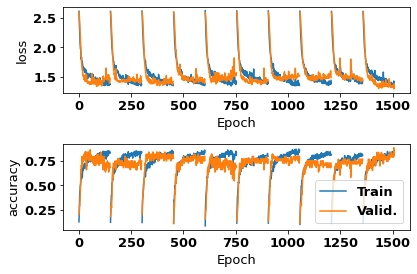

In [136]:
from indl.metrics import quickplot_history
tmp = rules[learned]
_rules = np.zeros(len(tmp))
unique = np.unique(tmp)
for i in range(len(tmp)):
    for j in range(len(unique)):
        if tmp[i] == unique[j]:
            _rules[i] = j
_rules = _rules.astype(int)

history, accuracy = get_hists_acc(sess_id,X_rates[learned], _rules, name="lr2r", verbose=2)
quickplot_history(history)

Processing session sra3_1_j_050_00_v1...
	Split 1 of 10


C:\Users\Alireza\miniconda3\envs\dl\lib\site-packages\sklearn\model_selection\_split.py:666: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=10.
  warnings.warn(("The least populated class in y has only %d"


Epoch 1/150

Epoch 00001: val_accuracy improved from -inf to 0.10000, saving model to ulr2r_sra3_1_j_050_00_v1old_split0.h5
10/10 - 1s - loss: 2.5156 - accuracy: 0.0562 - val_loss: 2.4376 - val_accuracy: 0.1000
Epoch 2/150

Epoch 00002: val_accuracy improved from 0.10000 to 0.20000, saving model to ulr2r_sra3_1_j_050_00_v1old_split0.h5
10/10 - 0s - loss: 2.4178 - accuracy: 0.0875 - val_loss: 2.4279 - val_accuracy: 0.2000
Epoch 3/150

Epoch 00003: val_accuracy improved from 0.20000 to 0.35000, saving model to ulr2r_sra3_1_j_050_00_v1old_split0.h5
10/10 - 0s - loss: 2.3715 - accuracy: 0.2188 - val_loss: 2.4181 - val_accuracy: 0.3500
Epoch 4/150

Epoch 00004: val_accuracy improved from 0.35000 to 0.40000, saving model to ulr2r_sra3_1_j_050_00_v1old_split0.h5
10/10 - 0s - loss: 2.3198 - accuracy: 0.2937 - val_loss: 2.4069 - val_accuracy: 0.4000
Epoch 5/150

Epoch 00005: val_accuracy did not improve from 0.40000
10/10 - 0s - loss: 2.2788 - accuracy: 0.3125 - val_loss: 2.3895 - val_accuracy:

Epoch 50/150

Epoch 00050: val_accuracy did not improve from 0.70000
10/10 - 0s - loss: 1.4746 - accuracy: 0.6812 - val_loss: 1.5567 - val_accuracy: 0.6500
Epoch 51/150

Epoch 00051: val_accuracy did not improve from 0.70000
10/10 - 0s - loss: 1.5331 - accuracy: 0.6812 - val_loss: 1.5416 - val_accuracy: 0.6500
Epoch 52/150

Epoch 00052: val_accuracy did not improve from 0.70000
10/10 - 0s - loss: 1.4533 - accuracy: 0.6562 - val_loss: 1.5698 - val_accuracy: 0.6000
Epoch 53/150

Epoch 00053: val_accuracy did not improve from 0.70000
10/10 - 0s - loss: 1.4830 - accuracy: 0.6875 - val_loss: 1.5688 - val_accuracy: 0.6000
Epoch 54/150

Epoch 00054: val_accuracy did not improve from 0.70000
10/10 - 0s - loss: 1.4286 - accuracy: 0.7625 - val_loss: 1.5159 - val_accuracy: 0.6500
Epoch 55/150

Epoch 00055: val_accuracy did not improve from 0.70000
10/10 - 0s - loss: 1.5105 - accuracy: 0.6313 - val_loss: 1.5306 - val_accuracy: 0.6500
Epoch 56/150

Epoch 00056: val_accuracy did not improve from 0.7

Epoch 103/150

Epoch 00103: val_accuracy did not improve from 0.75000
10/10 - 0s - loss: 1.3003 - accuracy: 0.8313 - val_loss: 1.6942 - val_accuracy: 0.6000
Epoch 104/150

Epoch 00104: val_accuracy did not improve from 0.75000
10/10 - 0s - loss: 1.2591 - accuracy: 0.8625 - val_loss: 1.7700 - val_accuracy: 0.6500
Epoch 105/150

Epoch 00105: val_accuracy did not improve from 0.75000
10/10 - 0s - loss: 1.2313 - accuracy: 0.8438 - val_loss: 1.6955 - val_accuracy: 0.6500
Epoch 106/150

Epoch 00106: val_accuracy did not improve from 0.75000
10/10 - 0s - loss: 1.2242 - accuracy: 0.8500 - val_loss: 1.7315 - val_accuracy: 0.6500
Epoch 107/150

Epoch 00107: val_accuracy did not improve from 0.75000
10/10 - 0s - loss: 1.2710 - accuracy: 0.8375 - val_loss: 1.7483 - val_accuracy: 0.6500
Epoch 108/150

Epoch 00108: val_accuracy did not improve from 0.75000
10/10 - 0s - loss: 1.2368 - accuracy: 0.8500 - val_loss: 1.8749 - val_accuracy: 0.6000
Epoch 109/150

Epoch 00109: val_accuracy did not improve f


Epoch 00004: val_accuracy improved from 0.31579 to 0.42105, saving model to ulr2r_sra3_1_j_050_00_v1old_split1.h5
10/10 - 0s - loss: 2.3168 - accuracy: 0.2750 - val_loss: 2.4060 - val_accuracy: 0.4211
Epoch 5/150

Epoch 00005: val_accuracy did not improve from 0.42105
10/10 - 0s - loss: 2.2499 - accuracy: 0.3875 - val_loss: 2.3886 - val_accuracy: 0.4211
Epoch 6/150

Epoch 00006: val_accuracy did not improve from 0.42105
10/10 - 0s - loss: 2.2229 - accuracy: 0.3812 - val_loss: 2.3662 - val_accuracy: 0.4211
Epoch 7/150

Epoch 00007: val_accuracy improved from 0.42105 to 0.47368, saving model to ulr2r_sra3_1_j_050_00_v1old_split1.h5
10/10 - 0s - loss: 2.1659 - accuracy: 0.4125 - val_loss: 2.3355 - val_accuracy: 0.4737
Epoch 8/150

Epoch 00008: val_accuracy did not improve from 0.47368
10/10 - 0s - loss: 2.1199 - accuracy: 0.4563 - val_loss: 2.3014 - val_accuracy: 0.4737
Epoch 9/150

Epoch 00009: val_accuracy did not improve from 0.47368
10/10 - 0s - loss: 2.0999 - accuracy: 0.3812 - val_

Epoch 55/150

Epoch 00055: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.5002 - accuracy: 0.6250 - val_loss: 1.4705 - val_accuracy: 0.5789
Epoch 56/150

Epoch 00056: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.5350 - accuracy: 0.6313 - val_loss: 1.4900 - val_accuracy: 0.5789
Epoch 57/150

Epoch 00057: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.5044 - accuracy: 0.6625 - val_loss: 1.5318 - val_accuracy: 0.5789
Epoch 58/150

Epoch 00058: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.5442 - accuracy: 0.6313 - val_loss: 1.5378 - val_accuracy: 0.6316
Epoch 59/150

Epoch 00059: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.4977 - accuracy: 0.6000 - val_loss: 1.5341 - val_accuracy: 0.5789
Epoch 60/150

Epoch 00060: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.4994 - accuracy: 0.6750 - val_loss: 1.4952 - val_accuracy: 0.5789
Epoch 61/150

Epoch 00061: val_accuracy did not improve from 0.6

Epoch 107/150

Epoch 00107: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.3584 - accuracy: 0.8000 - val_loss: 1.5994 - val_accuracy: 0.5789
Epoch 108/150

Epoch 00108: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.3040 - accuracy: 0.8062 - val_loss: 1.5944 - val_accuracy: 0.5789
Epoch 109/150

Epoch 00109: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.3537 - accuracy: 0.7750 - val_loss: 1.6620 - val_accuracy: 0.6316
Epoch 110/150

Epoch 00110: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.2975 - accuracy: 0.8188 - val_loss: 1.5677 - val_accuracy: 0.6316
Epoch 111/150

Epoch 00111: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.3380 - accuracy: 0.8188 - val_loss: 1.5254 - val_accuracy: 0.6316
Epoch 112/150

Epoch 00112: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.2893 - accuracy: 0.8313 - val_loss: 1.5298 - val_accuracy: 0.6842
Epoch 113/150

Epoch 00113: val_accuracy did not improve f

Epoch 8/150

Epoch 00008: val_accuracy did not improve from 0.42105
10/10 - 0s - loss: 2.1217 - accuracy: 0.4500 - val_loss: 2.3268 - val_accuracy: 0.4211
Epoch 9/150

Epoch 00009: val_accuracy did not improve from 0.42105
10/10 - 0s - loss: 2.1112 - accuracy: 0.4250 - val_loss: 2.2930 - val_accuracy: 0.3684
Epoch 10/150

Epoch 00010: val_accuracy did not improve from 0.42105
10/10 - 0s - loss: 2.0473 - accuracy: 0.4375 - val_loss: 2.2679 - val_accuracy: 0.4211
Epoch 11/150

Epoch 00011: val_accuracy improved from 0.42105 to 0.47368, saving model to ulr2r_sra3_1_j_050_00_v1old_split2.h5
10/10 - 0s - loss: 2.0036 - accuracy: 0.4500 - val_loss: 2.2325 - val_accuracy: 0.4737
Epoch 12/150

Epoch 00012: val_accuracy did not improve from 0.47368
10/10 - 0s - loss: 1.9386 - accuracy: 0.5000 - val_loss: 2.1937 - val_accuracy: 0.4737
Epoch 13/150

Epoch 00013: val_accuracy did not improve from 0.47368
10/10 - 0s - loss: 1.8726 - accuracy: 0.4875 - val_loss: 2.1533 - val_accuracy: 0.4737
Epoch 1

Epoch 59/150

Epoch 00059: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.4401 - accuracy: 0.6812 - val_loss: 1.5731 - val_accuracy: 0.6316
Epoch 60/150

Epoch 00060: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.4419 - accuracy: 0.7188 - val_loss: 1.5983 - val_accuracy: 0.6316
Epoch 61/150

Epoch 00061: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.3930 - accuracy: 0.7250 - val_loss: 1.6097 - val_accuracy: 0.5789
Epoch 62/150

Epoch 00062: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.4281 - accuracy: 0.7437 - val_loss: 1.6253 - val_accuracy: 0.5789
Epoch 63/150

Epoch 00063: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.4234 - accuracy: 0.7437 - val_loss: 1.5404 - val_accuracy: 0.6316
Epoch 64/150

Epoch 00064: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.4095 - accuracy: 0.7750 - val_loss: 1.5403 - val_accuracy: 0.6316
Epoch 65/150

Epoch 00065: val_accuracy did not improve from 0.6

Epoch 112/150

Epoch 00112: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.2721 - accuracy: 0.8062 - val_loss: 1.7737 - val_accuracy: 0.5789
Epoch 113/150

Epoch 00113: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.2816 - accuracy: 0.8313 - val_loss: 1.8188 - val_accuracy: 0.5789
Epoch 114/150

Epoch 00114: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.2496 - accuracy: 0.8438 - val_loss: 1.8235 - val_accuracy: 0.5789
Epoch 115/150

Epoch 00115: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.2858 - accuracy: 0.8188 - val_loss: 1.7936 - val_accuracy: 0.5789
Epoch 116/150

Epoch 00116: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.2804 - accuracy: 0.8188 - val_loss: 1.7047 - val_accuracy: 0.6316
Epoch 117/150

Epoch 00117: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.2141 - accuracy: 0.8625 - val_loss: 1.8384 - val_accuracy: 0.5789
Epoch 118/150

Epoch 00118: val_accuracy did not improve f

Epoch 12/150

Epoch 00012: val_accuracy did not improve from 0.52632
10/10 - 0s - loss: 1.9865 - accuracy: 0.4125 - val_loss: 2.1730 - val_accuracy: 0.5263
Epoch 13/150

Epoch 00013: val_accuracy did not improve from 0.52632
10/10 - 0s - loss: 1.8964 - accuracy: 0.5562 - val_loss: 2.1217 - val_accuracy: 0.5263
Epoch 14/150

Epoch 00014: val_accuracy did not improve from 0.52632
10/10 - 0s - loss: 1.9052 - accuracy: 0.4688 - val_loss: 2.0750 - val_accuracy: 0.5263
Epoch 15/150

Epoch 00015: val_accuracy did not improve from 0.52632
10/10 - 0s - loss: 1.8573 - accuracy: 0.5375 - val_loss: 2.0222 - val_accuracy: 0.5263
Epoch 16/150

Epoch 00016: val_accuracy improved from 0.52632 to 0.57895, saving model to ulr2r_sra3_1_j_050_00_v1old_split3.h5
10/10 - 0s - loss: 1.8203 - accuracy: 0.5250 - val_loss: 1.9721 - val_accuracy: 0.5789
Epoch 17/150

Epoch 00017: val_accuracy improved from 0.57895 to 0.68421, saving model to ulr2r_sra3_1_j_050_00_v1old_split3.h5
10/10 - 0s - loss: 1.7646 - accur

Epoch 64/150

Epoch 00064: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.4443 - accuracy: 0.6812 - val_loss: 1.4231 - val_accuracy: 0.6842
Epoch 65/150

Epoch 00065: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.4679 - accuracy: 0.6938 - val_loss: 1.4573 - val_accuracy: 0.6842
Epoch 66/150

Epoch 00066: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.4216 - accuracy: 0.7312 - val_loss: 1.4327 - val_accuracy: 0.6316
Epoch 67/150

Epoch 00067: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.4484 - accuracy: 0.7000 - val_loss: 1.4299 - val_accuracy: 0.6316
Epoch 68/150

Epoch 00068: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.4373 - accuracy: 0.7188 - val_loss: 1.4145 - val_accuracy: 0.6842
Epoch 69/150

Epoch 00069: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.4731 - accuracy: 0.7375 - val_loss: 1.5029 - val_accuracy: 0.5263
Epoch 70/150

Epoch 00070: val_accuracy did not improve from 0.7

Epoch 117/150

Epoch 00117: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.2682 - accuracy: 0.8625 - val_loss: 1.6403 - val_accuracy: 0.5263
Epoch 118/150

Epoch 00118: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.2384 - accuracy: 0.8562 - val_loss: 1.6531 - val_accuracy: 0.5263
Epoch 119/150

Epoch 00119: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.2764 - accuracy: 0.8500 - val_loss: 1.6432 - val_accuracy: 0.5263
Epoch 120/150

Epoch 00120: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.3160 - accuracy: 0.8625 - val_loss: 1.5635 - val_accuracy: 0.6316
Epoch 121/150

Epoch 00121: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.3404 - accuracy: 0.8062 - val_loss: 1.5358 - val_accuracy: 0.6316
Epoch 122/150

Epoch 00122: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.3766 - accuracy: 0.7437 - val_loss: 1.5510 - val_accuracy: 0.5789
Epoch 123/150

Epoch 00123: val_accuracy did not improve f

Epoch 18/150

Epoch 00018: val_accuracy did not improve from 0.52632
10/10 - 0s - loss: 1.7685 - accuracy: 0.5125 - val_loss: 1.9482 - val_accuracy: 0.5263
Epoch 19/150

Epoch 00019: val_accuracy did not improve from 0.52632
10/10 - 0s - loss: 1.7604 - accuracy: 0.5562 - val_loss: 1.9181 - val_accuracy: 0.5263
Epoch 20/150

Epoch 00020: val_accuracy did not improve from 0.52632
10/10 - 0s - loss: 1.7157 - accuracy: 0.5562 - val_loss: 1.8818 - val_accuracy: 0.5263
Epoch 21/150

Epoch 00021: val_accuracy did not improve from 0.52632
10/10 - 0s - loss: 1.7208 - accuracy: 0.5500 - val_loss: 1.8526 - val_accuracy: 0.5263
Epoch 22/150

Epoch 00022: val_accuracy improved from 0.52632 to 0.57895, saving model to ulr2r_sra3_1_j_050_00_v1old_split4.h5
10/10 - 0s - loss: 1.6959 - accuracy: 0.5750 - val_loss: 1.8301 - val_accuracy: 0.5789
Epoch 23/150

Epoch 00023: val_accuracy did not improve from 0.57895
10/10 - 0s - loss: 1.6923 - accuracy: 0.5500 - val_loss: 1.8099 - val_accuracy: 0.5263
Epoch

Epoch 70/150

Epoch 00070: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.4444 - accuracy: 0.7125 - val_loss: 1.5108 - val_accuracy: 0.6316
Epoch 71/150

Epoch 00071: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.4717 - accuracy: 0.6313 - val_loss: 1.5537 - val_accuracy: 0.5789
Epoch 72/150

Epoch 00072: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.5114 - accuracy: 0.5750 - val_loss: 1.4922 - val_accuracy: 0.6842
Epoch 73/150

Epoch 00073: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.4701 - accuracy: 0.6062 - val_loss: 1.5919 - val_accuracy: 0.5263
Epoch 74/150

Epoch 00074: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.4691 - accuracy: 0.6938 - val_loss: 1.5336 - val_accuracy: 0.6842
Epoch 75/150

Epoch 00075: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.4570 - accuracy: 0.6500 - val_loss: 1.5133 - val_accuracy: 0.5789
Epoch 76/150

Epoch 00076: val_accuracy did not improve from 0.6

Epoch 122/150

Epoch 00122: val_accuracy did not improve from 0.78947
10/10 - 0s - loss: 1.4046 - accuracy: 0.7250 - val_loss: 1.5685 - val_accuracy: 0.6842
Epoch 123/150

Epoch 00123: val_accuracy did not improve from 0.78947
10/10 - 0s - loss: 1.4006 - accuracy: 0.6938 - val_loss: 1.5716 - val_accuracy: 0.6316
Epoch 124/150

Epoch 00124: val_accuracy did not improve from 0.78947
10/10 - 0s - loss: 1.4279 - accuracy: 0.6938 - val_loss: 1.5047 - val_accuracy: 0.6842
Epoch 125/150

Epoch 00125: val_accuracy did not improve from 0.78947
10/10 - 0s - loss: 1.3790 - accuracy: 0.7625 - val_loss: 1.4954 - val_accuracy: 0.6842
Epoch 126/150

Epoch 00126: val_accuracy did not improve from 0.78947
10/10 - 0s - loss: 1.3647 - accuracy: 0.7312 - val_loss: 1.4843 - val_accuracy: 0.7368
Epoch 127/150

Epoch 00127: val_accuracy did not improve from 0.78947
10/10 - 0s - loss: 1.3858 - accuracy: 0.7750 - val_loss: 1.5071 - val_accuracy: 0.6316
Epoch 128/150

Epoch 00128: val_accuracy did not improve f

Epoch 22/150

Epoch 00022: val_accuracy did not improve from 0.57895
10/10 - 0s - loss: 1.6299 - accuracy: 0.5938 - val_loss: 1.7290 - val_accuracy: 0.5263
Epoch 23/150

Epoch 00023: val_accuracy improved from 0.57895 to 0.63158, saving model to ulr2r_sra3_1_j_050_00_v1old_split5.h5
10/10 - 0s - loss: 1.6837 - accuracy: 0.5500 - val_loss: 1.6567 - val_accuracy: 0.6316
Epoch 24/150

Epoch 00024: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.6556 - accuracy: 0.5688 - val_loss: 1.6480 - val_accuracy: 0.6316
Epoch 25/150

Epoch 00025: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.6401 - accuracy: 0.6187 - val_loss: 1.6265 - val_accuracy: 0.6316
Epoch 26/150

Epoch 00026: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.6481 - accuracy: 0.5875 - val_loss: 1.6086 - val_accuracy: 0.6316
Epoch 27/150

Epoch 00027: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.6571 - accuracy: 0.5375 - val_loss: 1.6222 - val_accuracy: 0.5263
Epoch

Epoch 74/150

Epoch 00074: val_accuracy did not improve from 0.78947
10/10 - 0s - loss: 1.4151 - accuracy: 0.7125 - val_loss: 1.3723 - val_accuracy: 0.6316
Epoch 75/150

Epoch 00075: val_accuracy did not improve from 0.78947
10/10 - 0s - loss: 1.4423 - accuracy: 0.6750 - val_loss: 1.3396 - val_accuracy: 0.7368
Epoch 76/150

Epoch 00076: val_accuracy did not improve from 0.78947
10/10 - 0s - loss: 1.4267 - accuracy: 0.6938 - val_loss: 1.3371 - val_accuracy: 0.6316
Epoch 77/150

Epoch 00077: val_accuracy did not improve from 0.78947
10/10 - 0s - loss: 1.4751 - accuracy: 0.7063 - val_loss: 1.3508 - val_accuracy: 0.6842
Epoch 78/150

Epoch 00078: val_accuracy did not improve from 0.78947
10/10 - 0s - loss: 1.4144 - accuracy: 0.7063 - val_loss: 1.3382 - val_accuracy: 0.6316
Epoch 79/150

Epoch 00079: val_accuracy did not improve from 0.78947
10/10 - 0s - loss: 1.3568 - accuracy: 0.7750 - val_loss: 1.3502 - val_accuracy: 0.6316
Epoch 80/150

Epoch 00080: val_accuracy did not improve from 0.7

Epoch 127/150

Epoch 00127: val_accuracy did not improve from 0.78947
10/10 - 0s - loss: 1.2750 - accuracy: 0.8250 - val_loss: 1.4272 - val_accuracy: 0.6842
Epoch 128/150

Epoch 00128: val_accuracy did not improve from 0.78947
10/10 - 0s - loss: 1.2955 - accuracy: 0.7937 - val_loss: 1.4724 - val_accuracy: 0.6842
Epoch 129/150

Epoch 00129: val_accuracy did not improve from 0.78947
10/10 - 0s - loss: 1.2674 - accuracy: 0.8625 - val_loss: 1.4753 - val_accuracy: 0.7368
Epoch 130/150

Epoch 00130: val_accuracy did not improve from 0.78947
10/10 - 0s - loss: 1.2593 - accuracy: 0.8562 - val_loss: 1.5176 - val_accuracy: 0.6842
Epoch 131/150

Epoch 00131: val_accuracy did not improve from 0.78947
10/10 - 0s - loss: 1.2563 - accuracy: 0.8625 - val_loss: 1.5821 - val_accuracy: 0.6316
Epoch 132/150

Epoch 00132: val_accuracy did not improve from 0.78947
10/10 - 0s - loss: 1.2681 - accuracy: 0.8500 - val_loss: 1.4631 - val_accuracy: 0.6842
Epoch 133/150

Epoch 00133: val_accuracy did not improve f

Epoch 27/150

Epoch 00027: val_accuracy did not improve from 0.57895
10/10 - 0s - loss: 1.6606 - accuracy: 0.5625 - val_loss: 1.6497 - val_accuracy: 0.5789
Epoch 28/150

Epoch 00028: val_accuracy did not improve from 0.57895
10/10 - 0s - loss: 1.6462 - accuracy: 0.5938 - val_loss: 1.6292 - val_accuracy: 0.5789
Epoch 29/150

Epoch 00029: val_accuracy did not improve from 0.57895
10/10 - 0s - loss: 1.6385 - accuracy: 0.5625 - val_loss: 1.6159 - val_accuracy: 0.5789
Epoch 30/150

Epoch 00030: val_accuracy did not improve from 0.57895
10/10 - 0s - loss: 1.6432 - accuracy: 0.6062 - val_loss: 1.6043 - val_accuracy: 0.5789
Epoch 31/150

Epoch 00031: val_accuracy did not improve from 0.57895
10/10 - 0s - loss: 1.6459 - accuracy: 0.5437 - val_loss: 1.5906 - val_accuracy: 0.5789
Epoch 32/150

Epoch 00032: val_accuracy did not improve from 0.57895
10/10 - 0s - loss: 1.6027 - accuracy: 0.5875 - val_loss: 1.5676 - val_accuracy: 0.5789
Epoch 33/150

Epoch 00033: val_accuracy did not improve from 0.5

Epoch 79/150

Epoch 00079: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.4423 - accuracy: 0.7312 - val_loss: 1.4250 - val_accuracy: 0.6842
Epoch 80/150

Epoch 00080: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.3758 - accuracy: 0.7312 - val_loss: 1.4296 - val_accuracy: 0.6842
Epoch 81/150

Epoch 00081: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.3856 - accuracy: 0.7688 - val_loss: 1.4439 - val_accuracy: 0.6842
Epoch 82/150

Epoch 00082: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.4285 - accuracy: 0.7188 - val_loss: 1.4215 - val_accuracy: 0.6842
Epoch 83/150

Epoch 00083: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.4842 - accuracy: 0.6687 - val_loss: 1.4380 - val_accuracy: 0.6842
Epoch 84/150

Epoch 00084: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.3666 - accuracy: 0.8062 - val_loss: 1.4416 - val_accuracy: 0.6842
Epoch 85/150

Epoch 00085: val_accuracy did not improve from 0.6

Epoch 131/150

Epoch 00131: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.2494 - accuracy: 0.8813 - val_loss: 1.5296 - val_accuracy: 0.6842
Epoch 132/150

Epoch 00132: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.2711 - accuracy: 0.8562 - val_loss: 1.5359 - val_accuracy: 0.6842
Epoch 133/150

Epoch 00133: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.2851 - accuracy: 0.8562 - val_loss: 1.5366 - val_accuracy: 0.6842
Epoch 134/150

Epoch 00134: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.2874 - accuracy: 0.8500 - val_loss: 1.5124 - val_accuracy: 0.7368
Epoch 135/150

Epoch 00135: val_accuracy improved from 0.73684 to 0.78947, saving model to ulr2r_sra3_1_j_050_00_v1old_split6.h5
10/10 - 0s - loss: 1.3234 - accuracy: 0.8625 - val_loss: 1.5286 - val_accuracy: 0.7895
Epoch 136/150

Epoch 00136: val_accuracy did not improve from 0.78947
10/10 - 0s - loss: 1.2705 - accuracy: 0.8250 - val_loss: 1.5364 - val_accuracy: 0.6316

Epoch 32/150

Epoch 00032: val_accuracy did not improve from 0.47368
10/10 - 0s - loss: 1.6017 - accuracy: 0.5500 - val_loss: 1.7086 - val_accuracy: 0.3684
Epoch 33/150

Epoch 00033: val_accuracy did not improve from 0.47368
10/10 - 0s - loss: 1.6104 - accuracy: 0.6000 - val_loss: 1.6906 - val_accuracy: 0.4211
Epoch 34/150

Epoch 00034: val_accuracy did not improve from 0.47368
10/10 - 0s - loss: 1.6085 - accuracy: 0.5625 - val_loss: 1.6756 - val_accuracy: 0.4211
Epoch 35/150

Epoch 00035: val_accuracy did not improve from 0.47368
10/10 - 0s - loss: 1.6005 - accuracy: 0.5875 - val_loss: 1.6642 - val_accuracy: 0.4211
Epoch 36/150

Epoch 00036: val_accuracy did not improve from 0.47368
10/10 - 0s - loss: 1.5519 - accuracy: 0.5938 - val_loss: 1.6463 - val_accuracy: 0.4737
Epoch 37/150

Epoch 00037: val_accuracy did not improve from 0.47368
10/10 - 0s - loss: 1.5734 - accuracy: 0.5938 - val_loss: 1.6593 - val_accuracy: 0.4737
Epoch 38/150

Epoch 00038: val_accuracy did not improve from 0.4

Epoch 84/150

Epoch 00084: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.4057 - accuracy: 0.7500 - val_loss: 1.5784 - val_accuracy: 0.5263
Epoch 85/150

Epoch 00085: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.3997 - accuracy: 0.8062 - val_loss: 1.6241 - val_accuracy: 0.5263
Epoch 86/150

Epoch 00086: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.4013 - accuracy: 0.7625 - val_loss: 1.6143 - val_accuracy: 0.5789
Epoch 87/150

Epoch 00087: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.3665 - accuracy: 0.7812 - val_loss: 1.6554 - val_accuracy: 0.5789
Epoch 88/150

Epoch 00088: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.4002 - accuracy: 0.7437 - val_loss: 1.6060 - val_accuracy: 0.5263
Epoch 89/150

Epoch 00089: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.3709 - accuracy: 0.8062 - val_loss: 1.6677 - val_accuracy: 0.5789
Epoch 90/150

Epoch 00090: val_accuracy did not improve from 0.6

Epoch 137/150

Epoch 00137: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.2638 - accuracy: 0.8562 - val_loss: 1.6852 - val_accuracy: 0.5263
Epoch 138/150

Epoch 00138: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.2869 - accuracy: 0.8125 - val_loss: 1.6770 - val_accuracy: 0.5263
Epoch 139/150

Epoch 00139: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.3210 - accuracy: 0.7937 - val_loss: 1.6458 - val_accuracy: 0.5789
Epoch 140/150

Epoch 00140: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.2931 - accuracy: 0.8313 - val_loss: 1.5793 - val_accuracy: 0.6316
Epoch 141/150

Epoch 00141: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.2754 - accuracy: 0.8125 - val_loss: 1.6407 - val_accuracy: 0.5789
Epoch 142/150

Epoch 00142: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.2667 - accuracy: 0.8125 - val_loss: 1.6507 - val_accuracy: 0.5789
Epoch 143/150

Epoch 00143: val_accuracy did not improve f


Epoch 00036: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.5984 - accuracy: 0.6062 - val_loss: 1.5612 - val_accuracy: 0.5263
Epoch 37/150

Epoch 00037: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.5949 - accuracy: 0.5750 - val_loss: 1.5558 - val_accuracy: 0.5263
Epoch 38/150

Epoch 00038: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.5799 - accuracy: 0.5750 - val_loss: 1.5460 - val_accuracy: 0.5263
Epoch 39/150

Epoch 00039: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.5602 - accuracy: 0.5625 - val_loss: 1.5315 - val_accuracy: 0.5263
Epoch 40/150

Epoch 00040: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.6056 - accuracy: 0.5063 - val_loss: 1.5218 - val_accuracy: 0.5263
Epoch 41/150

Epoch 00041: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.5805 - accuracy: 0.6250 - val_loss: 1.5117 - val_accuracy: 0.5263
Epoch 42/150

Epoch 00042: val_accuracy did not improve from 0.63158
10/10 - 

Epoch 89/150

Epoch 00089: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.4316 - accuracy: 0.7375 - val_loss: 1.4838 - val_accuracy: 0.6842
Epoch 90/150

Epoch 00090: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.4555 - accuracy: 0.6500 - val_loss: 1.4737 - val_accuracy: 0.6316
Epoch 91/150

Epoch 00091: val_accuracy did not improve from 0.68421
10/10 - 0s - loss: 1.4060 - accuracy: 0.7312 - val_loss: 1.4590 - val_accuracy: 0.6842
Epoch 92/150

Epoch 00092: val_accuracy improved from 0.68421 to 0.73684, saving model to ulr2r_sra3_1_j_050_00_v1old_split8.h5
10/10 - 0s - loss: 1.4087 - accuracy: 0.6687 - val_loss: 1.4514 - val_accuracy: 0.7368
Epoch 93/150

Epoch 00093: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.4066 - accuracy: 0.7125 - val_loss: 1.4543 - val_accuracy: 0.6842
Epoch 94/150

Epoch 00094: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.4219 - accuracy: 0.7188 - val_loss: 1.4441 - val_accuracy: 0.6842
Epoch

Epoch 141/150

Epoch 00141: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.3018 - accuracy: 0.8313 - val_loss: 1.4671 - val_accuracy: 0.6842
Epoch 142/150

Epoch 00142: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.3124 - accuracy: 0.8062 - val_loss: 1.5064 - val_accuracy: 0.6842
Epoch 143/150

Epoch 00143: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.2951 - accuracy: 0.8125 - val_loss: 1.4683 - val_accuracy: 0.6842
Epoch 144/150

Epoch 00144: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.2696 - accuracy: 0.8313 - val_loss: 1.4863 - val_accuracy: 0.6842
Epoch 145/150

Epoch 00145: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.2595 - accuracy: 0.8562 - val_loss: 1.4834 - val_accuracy: 0.6842
Epoch 146/150

Epoch 00146: val_accuracy did not improve from 0.73684
10/10 - 0s - loss: 1.3400 - accuracy: 0.8375 - val_loss: 1.4368 - val_accuracy: 0.6842
Epoch 147/150

Epoch 00147: val_accuracy did not improve f

Epoch 42/150

Epoch 00042: val_accuracy did not improve from 0.52632
10/10 - 0s - loss: 1.5311 - accuracy: 0.6062 - val_loss: 1.6447 - val_accuracy: 0.5263
Epoch 43/150

Epoch 00043: val_accuracy did not improve from 0.52632
10/10 - 0s - loss: 1.5324 - accuracy: 0.5437 - val_loss: 1.6627 - val_accuracy: 0.5263
Epoch 44/150

Epoch 00044: val_accuracy did not improve from 0.52632
10/10 - 0s - loss: 1.5130 - accuracy: 0.6000 - val_loss: 1.6584 - val_accuracy: 0.5263
Epoch 45/150

Epoch 00045: val_accuracy did not improve from 0.52632
10/10 - 0s - loss: 1.5174 - accuracy: 0.6313 - val_loss: 1.6667 - val_accuracy: 0.5263
Epoch 46/150

Epoch 00046: val_accuracy did not improve from 0.52632
10/10 - 0s - loss: 1.5106 - accuracy: 0.6500 - val_loss: 1.6546 - val_accuracy: 0.5263
Epoch 47/150

Epoch 00047: val_accuracy did not improve from 0.52632
10/10 - 0s - loss: 1.5162 - accuracy: 0.6062 - val_loss: 1.6536 - val_accuracy: 0.5263
Epoch 48/150

Epoch 00048: val_accuracy did not improve from 0.5

Epoch 94/150

Epoch 00094: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.3885 - accuracy: 0.7812 - val_loss: 1.7459 - val_accuracy: 0.5263
Epoch 95/150

Epoch 00095: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.4064 - accuracy: 0.7750 - val_loss: 1.6791 - val_accuracy: 0.5789
Epoch 96/150

Epoch 00096: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.3754 - accuracy: 0.7688 - val_loss: 1.6892 - val_accuracy: 0.5263
Epoch 97/150

Epoch 00097: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.3751 - accuracy: 0.7563 - val_loss: 1.6873 - val_accuracy: 0.5263
Epoch 98/150

Epoch 00098: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.3413 - accuracy: 0.7875 - val_loss: 1.6887 - val_accuracy: 0.5789
Epoch 99/150

Epoch 00099: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.3557 - accuracy: 0.7437 - val_loss: 1.6669 - val_accuracy: 0.5789
Epoch 100/150

Epoch 00100: val_accuracy did not improve from 0.

Epoch 147/150

Epoch 00147: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.3568 - accuracy: 0.7688 - val_loss: 1.9480 - val_accuracy: 0.5263
Epoch 148/150

Epoch 00148: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.2761 - accuracy: 0.8250 - val_loss: 1.9154 - val_accuracy: 0.4737
Epoch 149/150

Epoch 00149: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.2373 - accuracy: 0.8438 - val_loss: 1.9258 - val_accuracy: 0.5263
Epoch 150/150

Epoch 00150: val_accuracy did not improve from 0.63158
10/10 - 0s - loss: 1.2182 - accuracy: 0.8813 - val_loss: 1.9347 - val_accuracy: 0.5789
Session sra3_1_j_050_00_v1 overall accuracy: 0.0%


<ipython-input-53-84e58ebd63c0>:170: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  accuracy = 100 * np.sum(pred_y == true_y) / len(pred_y)


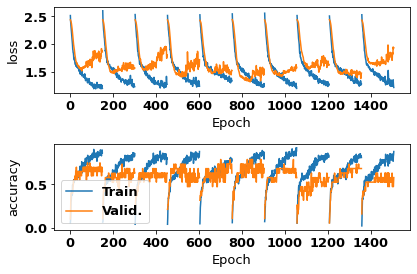

In [55]:
tmp = rules[unlearned]
_rules = np.zeros(len(tmp))
unique = np.unique(tmp)
for i in range(len(tmp)):
    for j in range(len(unique)):
        if tmp[i] == unique[j]:
            _rules[i] = j
_rules = _rules.astype(int)

history, accuracy = get_hists_acc(sess_id,X_rates[unlearned], _rules, name="ulr2r", verbose=2)
quickplot_history(history)

In [87]:
X_ul = X_rates[unlearned]
tmp = rules[unlearned]
Y_ul = np.zeros(len(tmp))
unique = np.unique(tmp)
for i in range(len(tmp)):
    for j in range(len(unique)):
        if tmp[i] == unique[j]:
            Y_ul[i] = j
Y_ul = Y_ul.astype(int)
print(np.unique(tmp, return_counts=True))
print(X_ul.shape, np.unique(Y_ul, return_counts=True))

(array([ 1,  2,  3,  4,  5,  6,  9, 10, 11, 12, 13]), array([ 1, 26, 14, 16,  9, 16, 30,  1, 47, 18, 13], dtype=int64))
(191, 32, 207) (array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10]), array([ 1, 26, 14, 16,  9, 16, 30,  1, 47, 18, 13], dtype=int64))


In [108]:
hidden_states = []
split = 0
model = tf.keras.models.load_model(f'ulr2r_sra3_1_j_050_00_v1old_split{split}.h5')
score_mean = np.zeros((11,11,207))
score_var = np.zeros((11,11,207))

for rul in range(11):
    idx = np.argwhere(Y_ul==rul).flatten()
    score = np.zeros((len(idx),11,np.size(X_ul,2)))

    for t in range(np.size(X_ul,2)):
        x_ts = X_ul[idx]
        x_ts[:,:,t:] = 0
        score[:,:,t] = model.predict(x_ts)
    score_mean[rul] = np.mean(score, axis=0)
    score_var[rul] = np.var(score, axis=0)

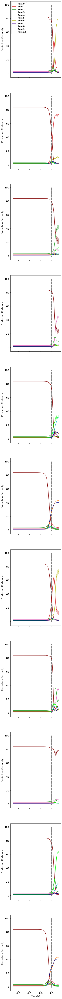

In [116]:
color_map = ['tab:blue', 'tab:red', 'tab:green', 'tab:pink','tab:cyan','tab:orange', 'tab:olive', 'tab:purple',
            'maroon', 'lime', 'navy', 'sienna']
fig, axs = plt.subplots(11,1,sharex=True,figsize=(5,100))
for rul in range(11):
    for scr in range(11):
        if rul==0:
            axs[rul].plot(times, 100*score_mean[rul, scr,:], color=color_map[scr], label=f'Rule {scr}')
        else:
            axs[rul].plot(times, 100*score_mean[rul, scr,:], color=color_map[scr])
        axs[rul].fill_between(times, 100*(score_mean[rul, scr,:]-score_var[rul, scr,:]), 100*(score_mean[rul, scr,:]+score_var[rul, scr,:]) ,alpha=0.3, color=color_map[scr])
        axs[rul].vlines(0.25, -1, 100, colors='grey', linestyles='dashed')
        axs[rul].vlines(1.5, -1, 100, colors='grey', linestyles='dashed')
        axs[rul].set(ylabel="Prediction Certainty")

axs[rul].set(xlabel="Time(s)")
axs[0].legend(loc='upper left', fontsize='small')

In [138]:
X_l = X_rates[learned]
tmp = rules[learned]
Y_l = np.zeros(len(tmp))
unique = np.unique(tmp)
for i in range(len(tmp)):
    for j in range(len(unique)):
        if tmp[i] == unique[j]:
            Y_l[i] = j
Y_l = Y_l.astype(int)
print(np.unique(tmp, return_counts=True))
print(X_l.shape, np.unique(Y_l, return_counts=True))

(array([ 0,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13]), array([29, 24,  8, 28, 86, 18, 23,  7, 33, 20, 38, 78, 46], dtype=int64))
(438, 32, 207) (array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]), array([29, 24,  8, 28, 86, 18, 23,  7, 33, 20, 38, 78, 46], dtype=int64))


In [139]:
split = 0
model = tf.keras.models.load_model(f'lr2r_sra3_1_j_050_00_v1old_split{split}.h5')
score_mean = np.zeros((13,13,207))
score_var = np.zeros((13,13,207))

for rul in range(13):
    idx = np.argwhere(Y_l==rul).flatten()
    score = np.zeros((len(idx),13,np.size(X_l,2)))

    for t in range(np.size(X_l,2)):
        x_ts = X_l[idx]
        x_ts[:,:,t:] = 0
        score[:,:,t] = model.predict(x_ts)
    score_mean[rul] = np.mean(score, axis=0)
    score_var[rul] = np.var(score, axis=0)

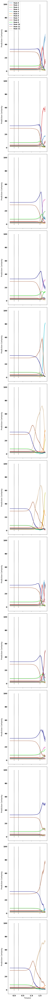

In [150]:
color_map = ['tab:blue', 'tab:red', 'tab:green', 'tab:pink','tab:cyan','tab:orange', 'tab:olive', 'tab:purple',
            'maroon', 'lime', 'navy', 'sienna', 'tan', 'black']
fig, axs = plt.subplots(13,1,sharex=True,figsize=(5,100))
for rul in range(13):
    for scr in range(13):
        if rul==0:
            axs[rul].plot(times, 100*score_mean[rul, scr,:], color=color_map[scr], label=f'Rule {scr}')
        else:
            axs[rul].plot(times, 100*score_mean[rul, scr,:], color=color_map[scr])
        axs[rul].fill_between(times, 100*(score_mean[rul, scr,:]-score_var[rul, scr,:]), 100*(score_mean[rul, scr,:]+score_var[rul, scr,:]) ,alpha=0.3, color=color_map[scr])
        axs[rul].vlines(0, -1, 100, colors='grey', linestyles='dashed')
        axs[rul].vlines(0.25, -1, 100, colors='grey', linestyles='dashed')
        axs[rul].vlines(1.5, -1, 100, colors='grey', linestyles='dashed')
        axs[rul].set(ylabel="Prediction Certainty")

axs[rul].set(xlabel="Time(s)")
axs[0].legend(loc='upper left', fontsize='small')
plt.tight_layout()
plt.savefig("rule_decode_through_time.svg")

In [148]:
axs[3].savefig("rdtt_l_3.svg")

AttributeError: 'AxesSubplot' object has no attribute 'savefig'

In [215]:
from tensorflow.keras.models import load_model
model = load_model("r2c_lstm_sra3_1_j_050_00+_split1.h5")
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 36, 186)]         0         
_________________________________________________________________
reshape (Reshape)            (None, 36, 186, 1)        0         
_________________________________________________________________
conv2d (Conv2D)              (None, 36, 167, 8)        168       
_________________________________________________________________
batch_normalization (BatchNo (None, 36, 167, 8)        32        
_________________________________________________________________
depthwise_conv2d (DepthwiseC (None, 1, 167, 8)         296       
_________________________________________________________________
batch_normalization_1 (Batch (None, 1, 167, 8)         32        
_________________________________________________________________
activation (Activation)      (None, 1, 167, 8)         0     

In [217]:
X_rates.shape

(1270, 274, 36)

In [218]:
X = np.transpose(X_rates, (0, 2, 1))
output_layer = -5
tbs = 30  # tsne batch size
truncated_model = tf.keras.Model(model.input, model.layers[output_layer].output)
flattened_output = []
for start_ix in range(0, X.shape[0], tbs):
#     flattened_output.append(truncated_model(X[start_ix:start_ix+tbs, MAX_OFFSET:, :].astype(np.float32)[:, :, :, None]))
    flattened_output.append(truncated_model(X[start_ix:start_ix+tbs, :, :].astype(np.float32)))
flattened_output = tf.concat(flattened_output, 0)

InvalidArgumentError: Input to reshape is a tensor with 295920 values, but the requested shape has 200880 [Op:Reshape]